# **Final Project: Complex Networks Theory and Applications (MAT933)**

Istitution: University of Zurich and Università degli studi di Torino  
Autor: **Stefano Sperti**

# Title : Measuring the Effictiveness of Hypergraph Community Detection


In [1]:
import sys
import os
import importlib

data_path = '../data/'

In [2]:
import hypergraphx as hx
from hypergraphx.core.hypergraph import Hypergraph
from hypergraphx.utils import normalize_array, calculate_permutation_matrix
from hypergraphx.communities.hy_sc.model import HySC
from hypergraphx.communities.hypergraph_mt.model import HypergraphMT
from hypergraphx.communities.hy_mmsbm.model import HyMMSBM
from hypergraphx.viz import draw_communities


import networkx as nx

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns

from k_clique_reduction import k_clique_reduction
from metrix import *
from modularity_graph import *
from bipartite_reduction import *
from methods_clustering import *
from evaluation_clustering import *

In [3]:
from import_graph import *
from empirical_analysis import *

# Hospital

In [4]:
file_path_hospital = '../data/hospital/hospital.npz'
file_path_ground_truth_hospital = '../data/hospital/hospital_meta.csv'
hyperedges_hospital = import_from_npz(file_path_hospital)


In [5]:
data = pd.read_csv(file_path_ground_truth_hospital)
true_community = {}
true_matrix = {}
for i in range(len(data)):
    if data['classID'][i] not in true_community:
        true_community[data['classID'][i]] = []
    true_community[data['classID'][i]].append(data['nodeID'][i])
    true_matrix[data['nodeID'][i]] = data['classID'][i]

number_community = len(true_community)
matrix = np.zeros((len(true_matrix), number_community))
for i in range(len(true_matrix)):
    matrix[i][true_matrix[i]-1] = 1

true_partition_hospital = true_community
true_matrix_hospital = matrix

In [6]:
number_community = true_matrix_hospital.shape[1]
print("True number of communities hospital: ", number_community)
min_number = 3
max_number = 8

True number of communities hospital:  4


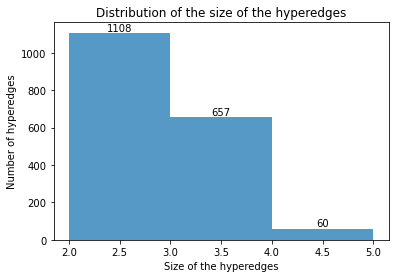

<Figure size 432x288 with 0 Axes>

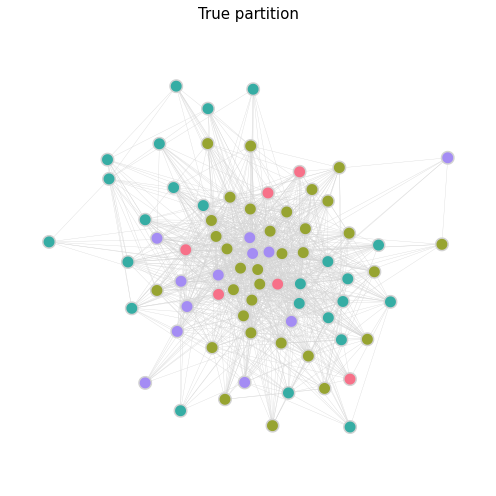

-----------------------------------------------------------------------------------
K -clique reduction
-----------------------------------------------------------------------------------


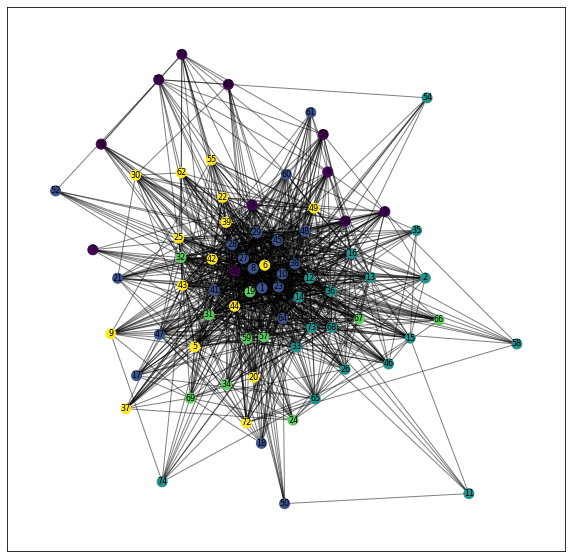

Adjusted Rand Index (ARI): 0.04306861392134865
Normalized Mutual Information (NMI): 0.039881107183963774
Conductance: 0.7331616398351544
Generalized Conductance: 4.8497676267821275


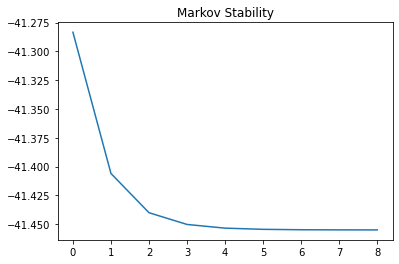

Number of partitions of K -clique reduction:  5
-----------------------------------------------------------------------------------
K -clique reduction weighting the hyperedges
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.007537282795713805
Normalized Mutual Information (NMI): 0.04742710691942799
Conductance: 0.6728900602243917
Generalized Conductance: 4.814936200538511


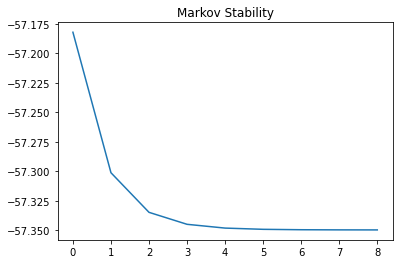

Number of partitions of K -clique reduction weighting the hyperedges:  4
-----------------------------------------------------------------------------------
Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.0177942705131501
Normalized Mutual Information (NMI): 0.04933113014920704
Conductance: 0.8962241799416321
Generalized Conductance: 3.94917374435762
Number of partitions:  16
-----------------------------------------------------------------------------------
Weighted Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.01896191547485136
Normalized Mutual Information (NMI): 0.03071989033632312
Conductance: 0.9167919670465278
Generalized Conductance: 4.66195967844585
Number of partitions:  20
-----------------------------------------------------------------------------------
Spectral clustering with number of commun

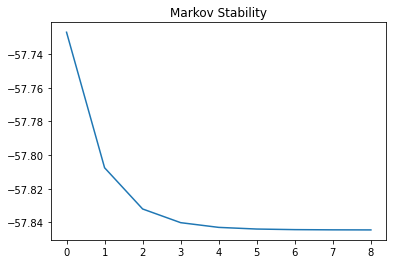

-----------------------------------------------------------------------------------
HyMMSBM with number of community of modularity
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.0273104194207427
Normalized Mutual Information (NMI): 0.05744128897623786
Conductance: 0.7313130723728272
Generalized Conductance: 5.075248250632623


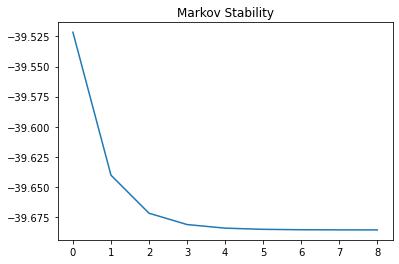

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


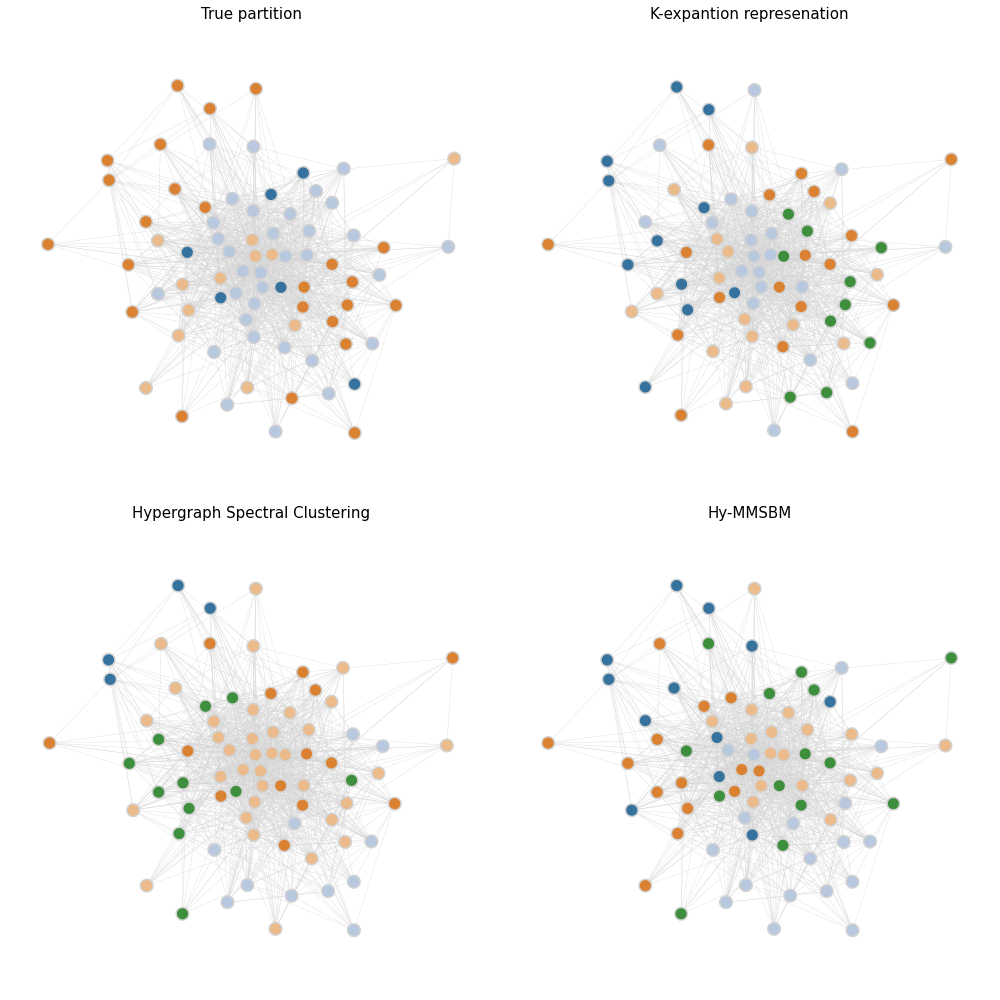

-----------------------------------------------------------------------------------
Spectral clustering with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.09520236000414035
Normalized Mutual Information (NMI): 0.08722452664897767
Conductance: 0.7157050889393304
Generalized Conductance: 3.5865947046821636


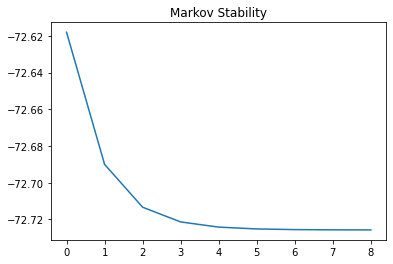

-----------------------------------------------------------------------------------
HyMMSBM with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.01031113299373189
Normalized Mutual Information (NMI): 0.03457681788241856
Conductance: 0.6927880066737635
Generalized Conductance: 5.15504536380174


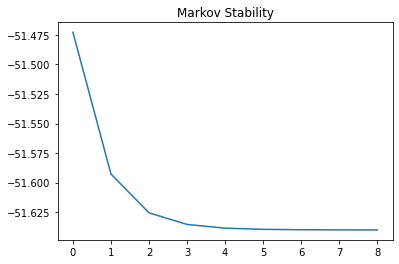

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


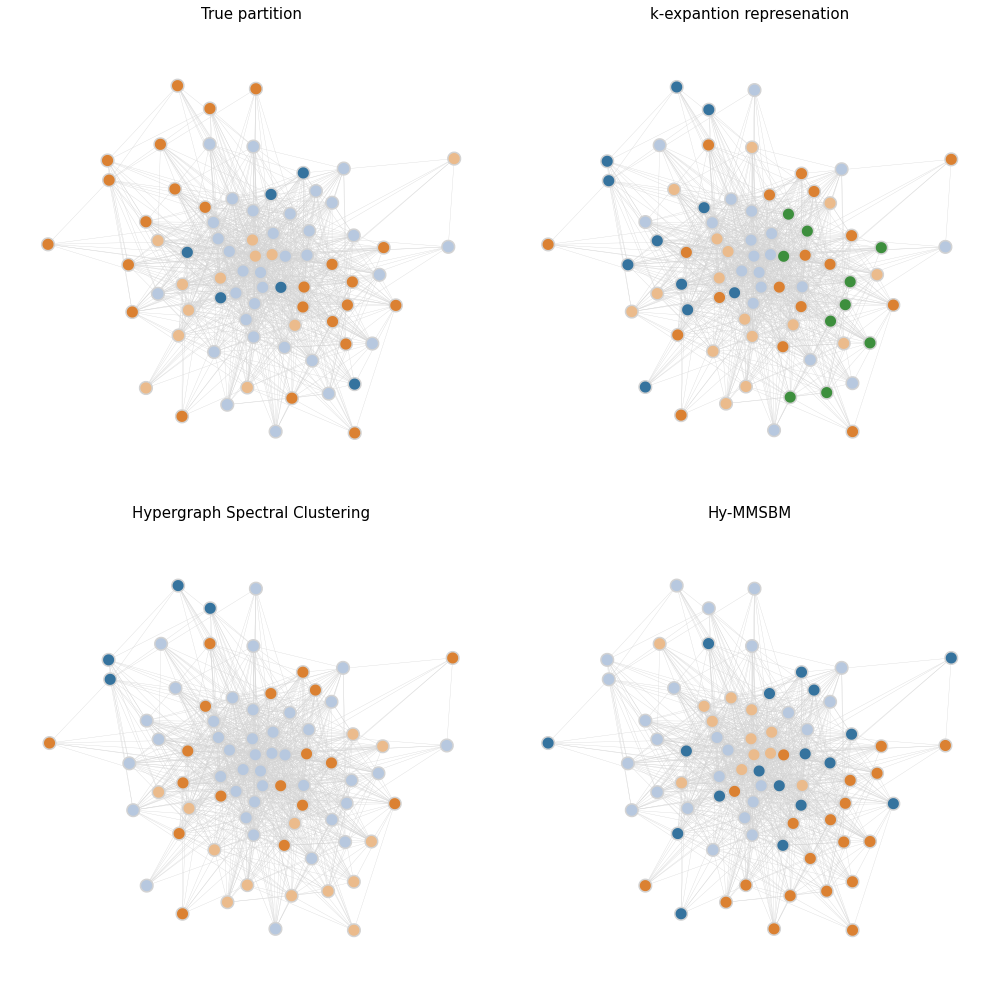

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


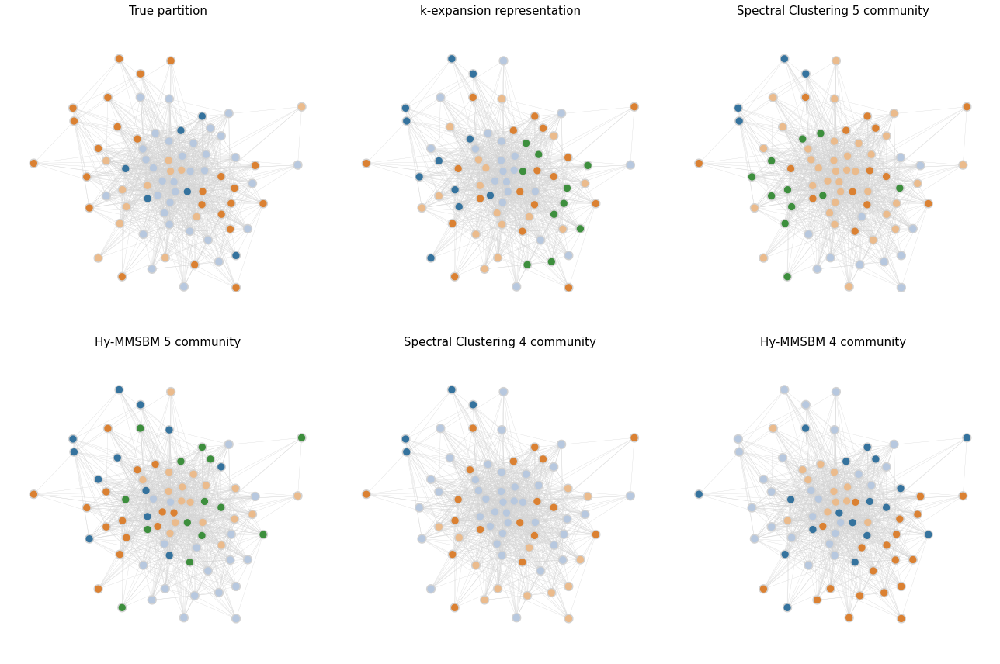

-----------------------------------------------------------------------------------
Spectral clustering choose of K
-----------------------------------------------------------------------------------
Number of communities:  3
Adjusted Rand Index (ARI): 0.0556751768686558
Normalized Mutual Information (NMI): 0.07624679600287354
Conductance: 0.6037575420031561
Generalized Conductance: 2.621568919003426
Number of communities:  4
Adjusted Rand Index (ARI): 0.09520236000414035
Normalized Mutual Information (NMI): 0.08722452664897767
Conductance: 0.7157050889393304
Generalized Conductance: 3.5865947046821636
Number of communities:  5
Adjusted Rand Index (ARI): 0.09737007895741266
Normalized Mutual Information (NMI): 0.08994989393081604
Conductance: 0.7338776752138381
Generalized Conductance: 3.175509746312945
Number of communities:  6
Adjusted Rand Index (ARI): 0.051181159455317995
Normalized Mutual Information (NMI): 0.07397011724465706
Conductance: 0.7624079213748253
Generalized Conductanc

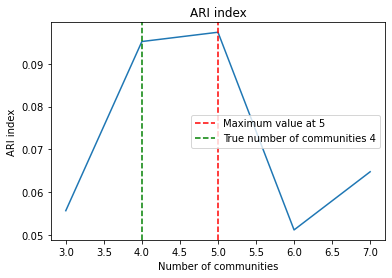

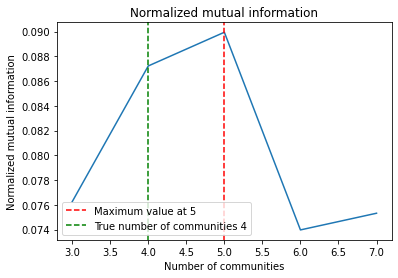

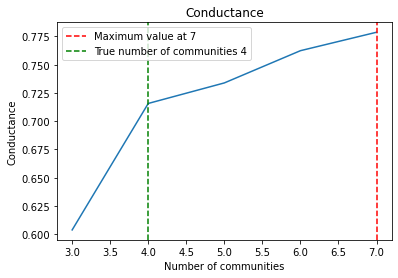

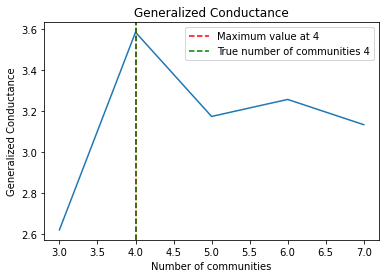

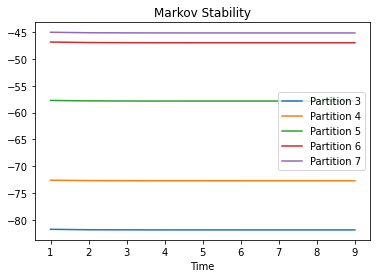

-----------------------------------------------------------------------------------
HyMMSBM choose of K
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.026793978202149564
Normalized Mutual Information (NMI): 0.03871423616702297
Conductance: 0.6863020549760781
Generalized Conductance: 5.241054808855768
Adjusted Rand Index (ARI): 0.015581413122396729
Normalized Mutual Information (NMI): 0.055841003585349644
Conductance: 0.6793066913272944
Generalized Conductance: 5.149623593410696
Adjusted Rand Index (ARI): 0.023632049469117754
Normalized Mutual Information (NMI): 0.059839816865904776
Conductance: 0.682267029269664
Generalized Conductance: 4.6296547447821235
Adjusted Rand Index (ARI): 0.015295831465710443
Normalized Mutual Information (NMI): 0.032189564607810445
Conductance: 0.6826899588834371
Generalized Conductance: 5.276093310593479
Adjusted Rand Index (ARI): 0.009510765458585549
Normalized Mutual Information (NMI): 0.03

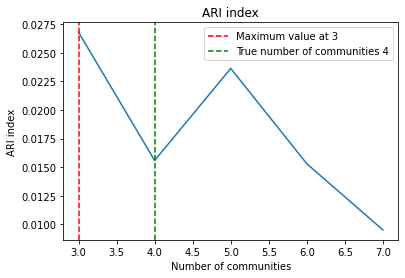

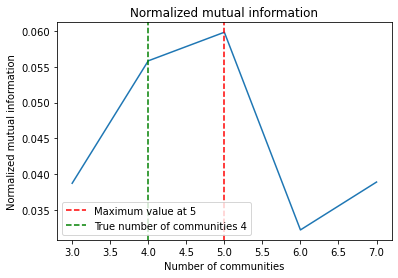

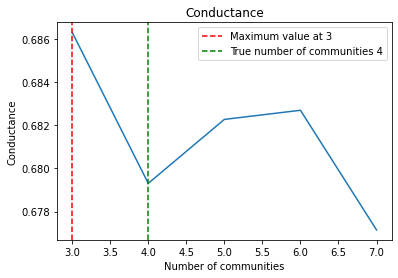

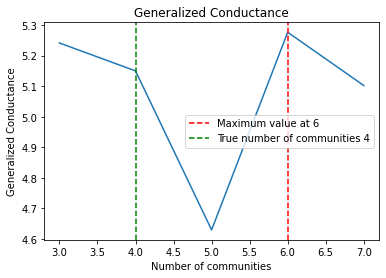

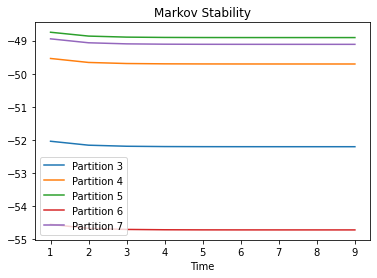

In [7]:
empirical_analysis_project(hyperedges_hospital, true_partition_hospital,
                           true_matrix_hospital, min_number, max_number, number_community,number_community)

## Primary school


In [8]:
file_path_primary_school = data_path + \
    "contact-primary-school-classes/hyperedges-contact-primary-school-classes.txt"
file_true_partition_primary_school = data_path + \
    "contact-primary-school-classes/node-labels-contact-primary-school-classes.txt"

true_partition_primary_school, true_matrix_primary_school = import_txt_true_one_community(
    file_true_partition_primary_school)
primary_school = import_txt_comma_hypergraph(file_path_primary_school)

n_community = true_matrix_primary_school.shape[1]
print("True number of communities high school: ",
      true_matrix_primary_school.shape[1])

True number of communities high school:  11


In [9]:
min_number = 3
max_number = 15
K = 11

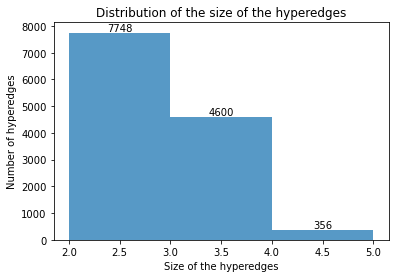

<Figure size 432x288 with 0 Axes>

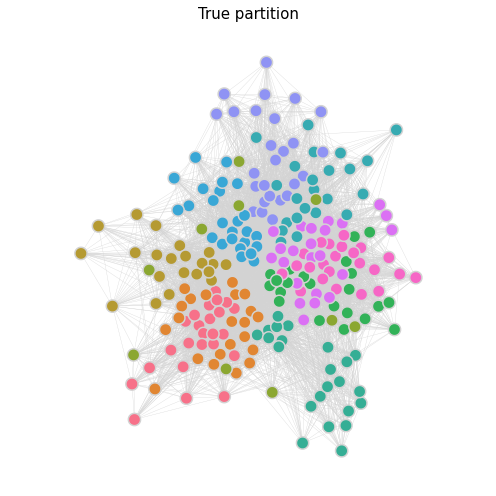

-----------------------------------------------------------------------------------
K -clique reduction
-----------------------------------------------------------------------------------


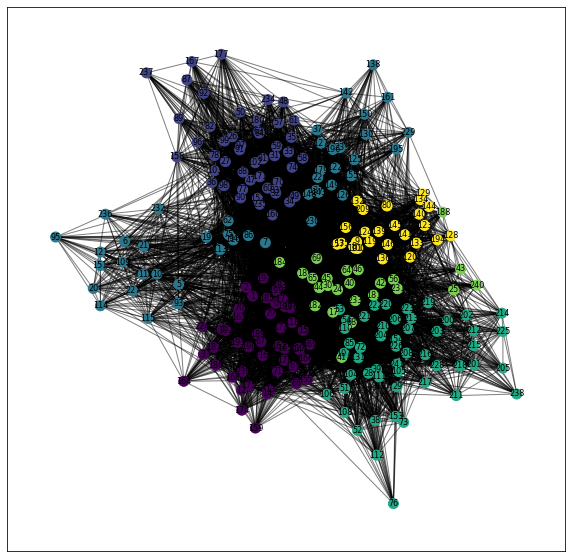

Adjusted Rand Index (ARI): 0.6232310651890034
Normalized Mutual Information (NMI): 0.5075837099598485
Conductance: 0.5658700270982044
Generalized Conductance: 3.0401893140026672


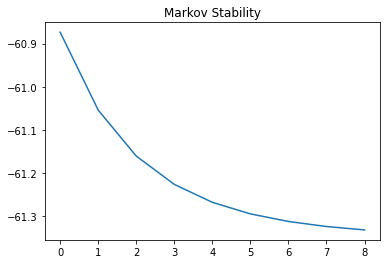

Number of partitions of K -clique reduction:  6
-----------------------------------------------------------------------------------
K -clique reduction weighting the hyperedges
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.6232310651890034
Normalized Mutual Information (NMI): 0.5075837099598485
Conductance: 0.5658700270982044
Generalized Conductance: 3.0401893140026672


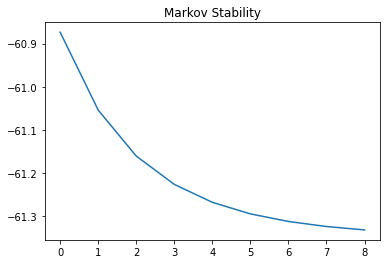

Number of partitions of K -clique reduction weighting the hyperedges:  6
-----------------------------------------------------------------------------------
Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.8379610746433784
Normalized Mutual Information (NMI): 0.7890943373728343
Conductance: 0.6356157810754091
Generalized Conductance: 3.079328966598953
Number of partitions:  9
-----------------------------------------------------------------------------------
Weighted Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.8466049098507524
Normalized Mutual Information (NMI): 0.8005554739600168
Conductance: 0.6342321688901629
Generalized Conductance: 3.8219534907004027
Number of partitions:  9
-----------------------------------------------------------------------------------
Spectral clustering with number of communit

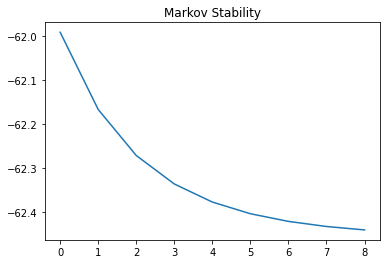

-----------------------------------------------------------------------------------
HyMMSBM with number of community of modularity
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.6238897392455572
Normalized Mutual Information (NMI): 0.5046227164246279
Conductance: 0.562396887395747
Generalized Conductance: 2.683833555049377


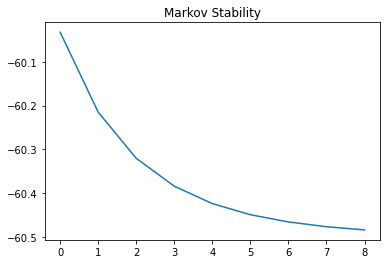

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


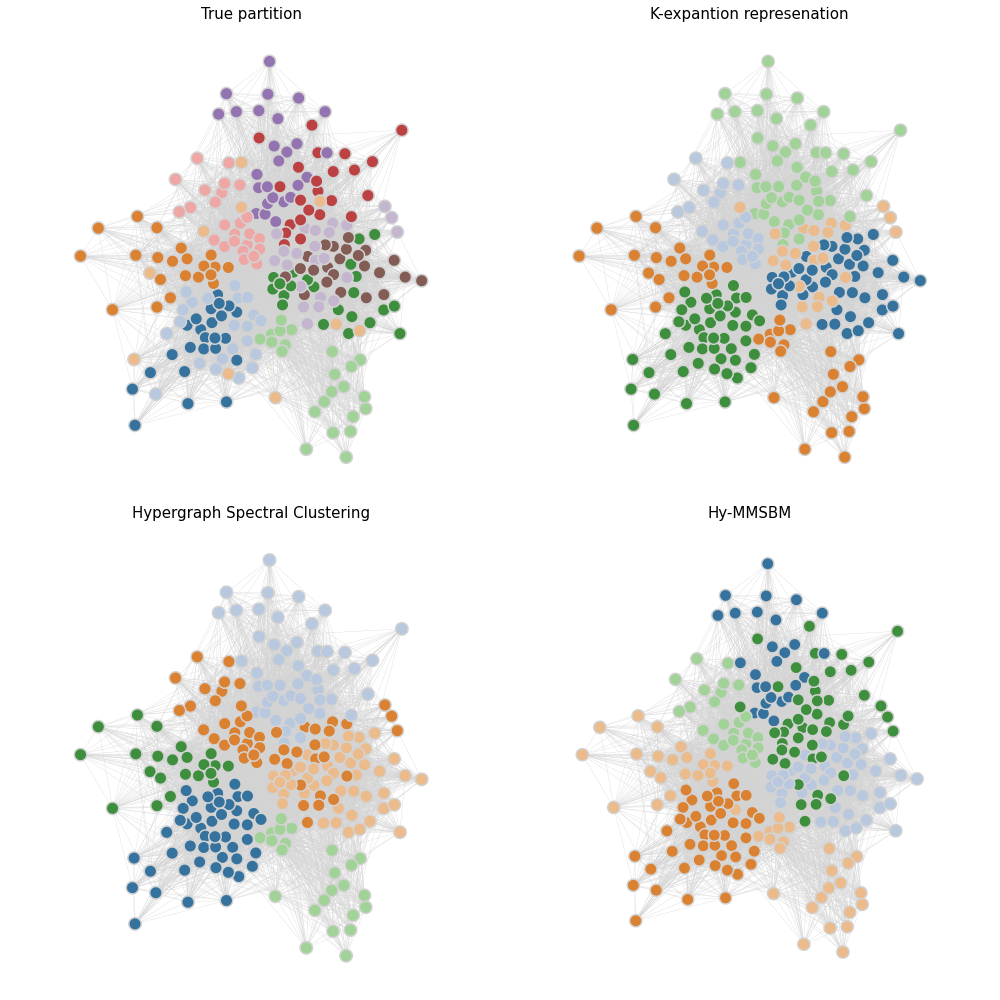

-----------------------------------------------------------------------------------
Spectral clustering with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.907825407935329
Normalized Mutual Information (NMI): 0.8494983528409861
Conductance: 0.6957906336200893
Generalized Conductance: 4.314147686652095


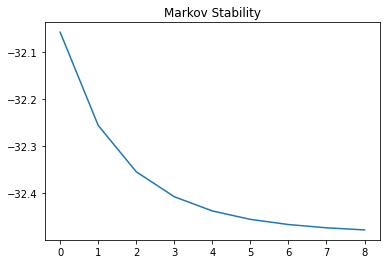

-----------------------------------------------------------------------------------
HyMMSBM with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.8776794586959462
Normalized Mutual Information (NMI): 0.8156227919977028
Conductance: 0.695517720197912
Generalized Conductance: 4.019088005317567


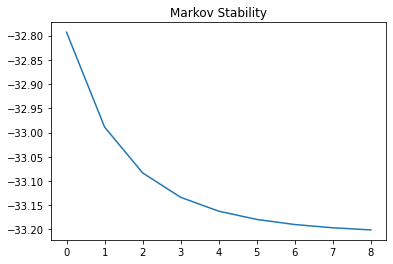

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


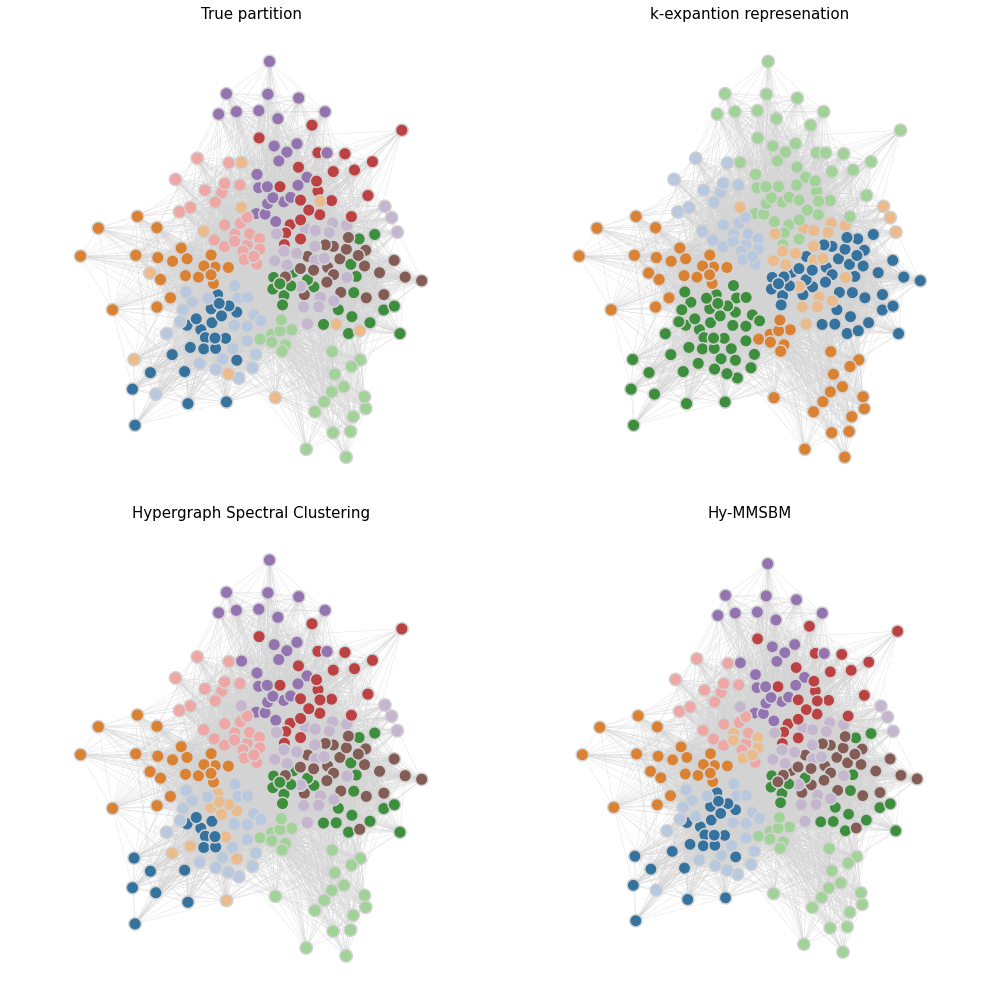

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


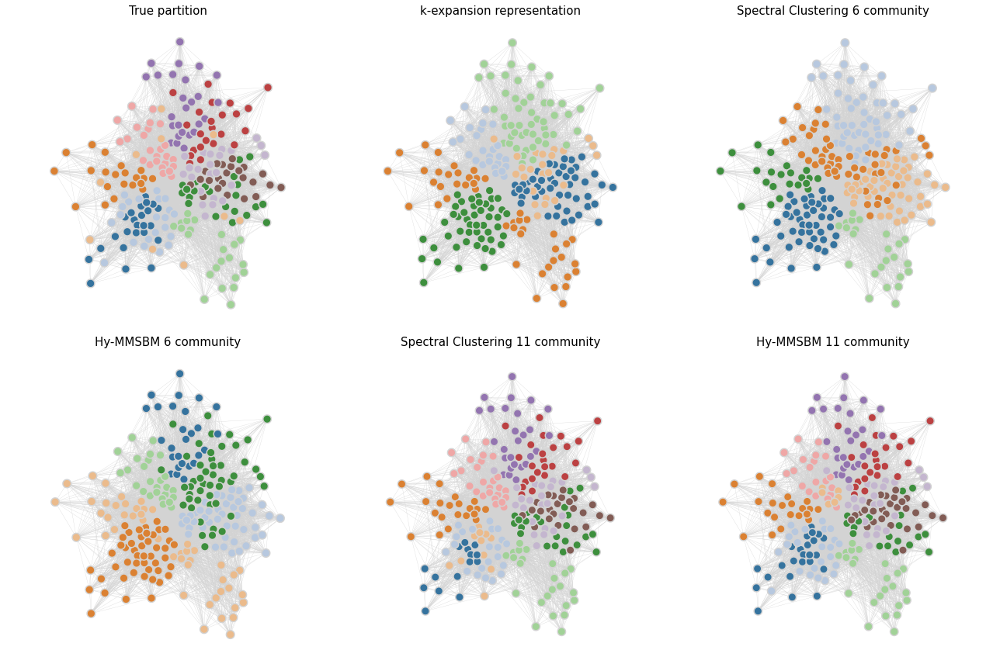

-----------------------------------------------------------------------------------
Spectral clustering choose of K
-----------------------------------------------------------------------------------
Number of communities:  3
Adjusted Rand Index (ARI): 0.285749158894742
Normalized Mutual Information (NMI): 0.20188825636660374
Conductance: 0.3958208613216944
Generalized Conductance: 0.8889128383306891
Number of communities:  4
Adjusted Rand Index (ARI): 0.391595985577681
Normalized Mutual Information (NMI): 0.3127558769441448
Conductance: 0.46419375539513547
Generalized Conductance: 1.4360050742097012
Number of communities:  5
Adjusted Rand Index (ARI): 0.5431941376191115
Normalized Mutual Information (NMI): 0.3952684261690896
Conductance: 0.523550966167372
Generalized Conductance: 1.8578641151721382
Number of communities:  6
Adjusted Rand Index (ARI): 0.6136216535148511
Normalized Mutual Information (NMI): 0.4997666026905708
Conductance: 0.5493840122629242
Generalized Conductance: 2.30

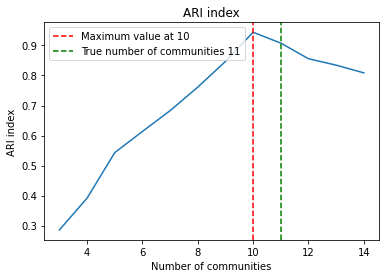

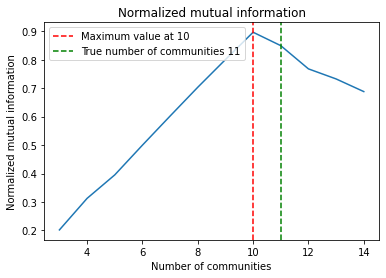

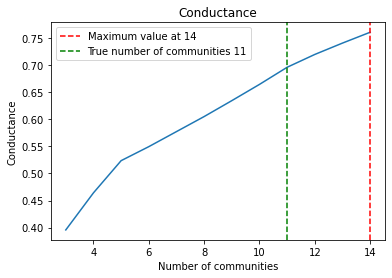

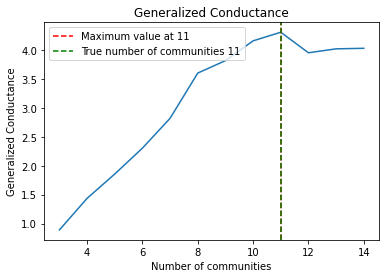

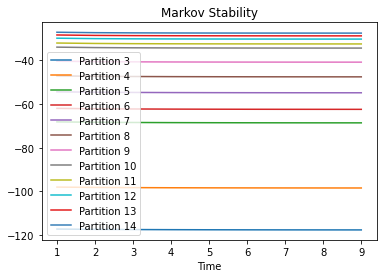

-----------------------------------------------------------------------------------
HyMMSBM choose of K
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.893276302284574
Normalized Mutual Information (NMI): 0.8305837267917037
Conductance: 0.6927461251220653
Generalized Conductance: 3.8646604459125538
Adjusted Rand Index (ARI): 0.8932086754327115
Normalized Mutual Information (NMI): 0.8299191898607953
Conductance: 0.6937487823140777
Generalized Conductance: 4.278104687473155
Adjusted Rand Index (ARI): 0.9048238618552135
Normalized Mutual Information (NMI): 0.8439034315843534
Conductance: 0.6936773418018501
Generalized Conductance: 3.8388866982163345
Adjusted Rand Index (ARI): 0.8927870291352391
Normalized Mutual Information (NMI): 0.8295984146828977
Conductance: 0.6934290377954542
Generalized Conductance: 3.7441011200570475
Adjusted Rand Index (ARI): 0.9018837700973201
Normalized Mutual Information (NMI): 0.8450123640528924


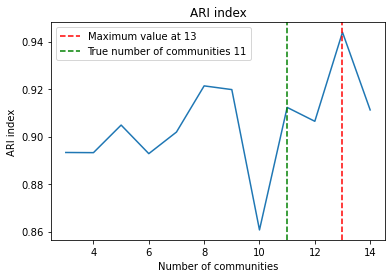

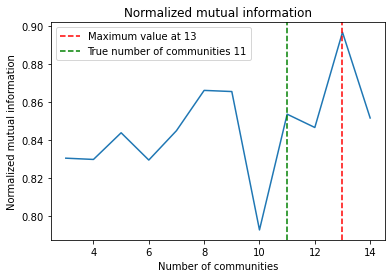

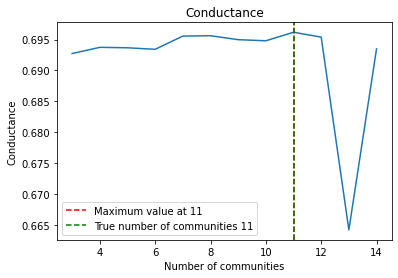

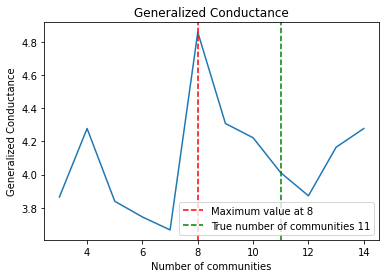

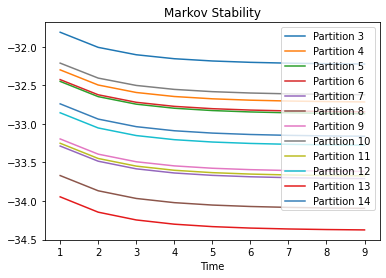

In [10]:
empirical_analysis_project(primary_school, true_partition_primary_school,
                           true_matrix_primary_school, min_number, max_number, K,n_community)

## High school


In [11]:
file_path_high_school = data_path + \
    "contact-high-school-classes/hyperedges-contact-high-school-classes.txt"
file_true_partition_high_school = data_path + \
    "contact-high-school-classes/node-labels-contact-high-school-classes.txt"

true_partition_high_school, true_matrix_high_school = import_txt_true_one_community(
    file_true_partition_high_school)
high_school = import_txt_comma_hypergraph(file_path_high_school)

n_community = true_matrix_high_school.shape[1]
print("True number of communities high school: ",n_community
      )

True number of communities high school:  9


In [12]:
min_number, max_number = 3, 14

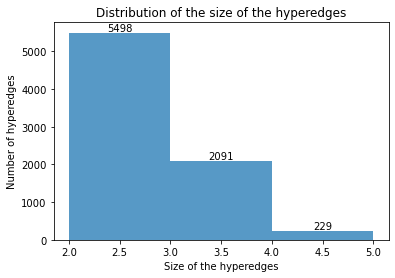

<Figure size 432x288 with 0 Axes>

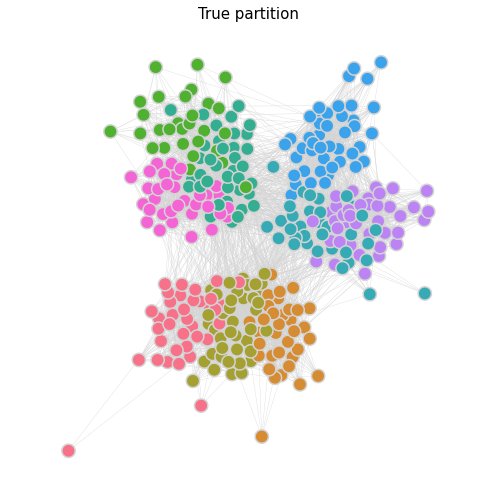

-----------------------------------------------------------------------------------
K -clique reduction
-----------------------------------------------------------------------------------


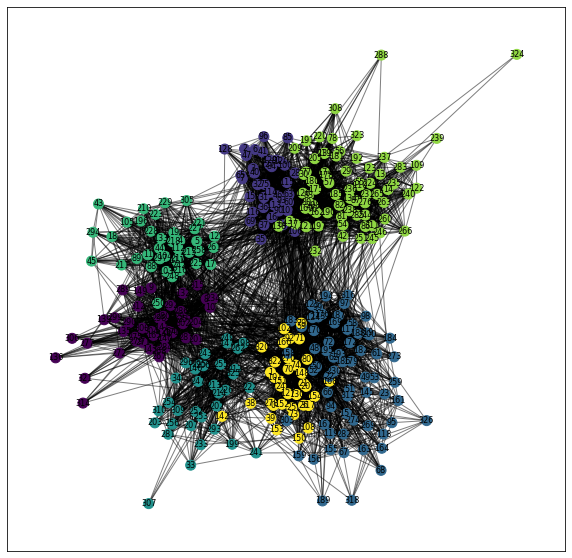

Adjusted Rand Index (ARI): 0.7952415821237442
Normalized Mutual Information (NMI): 0.7381926019074355
Conductance: 0.27666734041625346
Generalized Conductance: 0.64338778939471


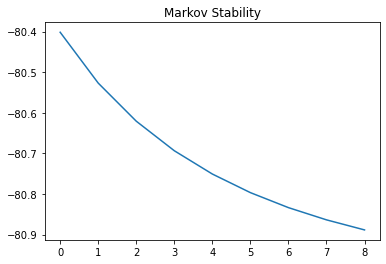

Number of partitions of K -clique reduction:  7
-----------------------------------------------------------------------------------
K -clique reduction weighting the hyperedges
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.902349083207053
Normalized Mutual Information (NMI): 0.8850597303983597
Conductance: 0.2912792994177881
Generalized Conductance: 1.3079281142863195


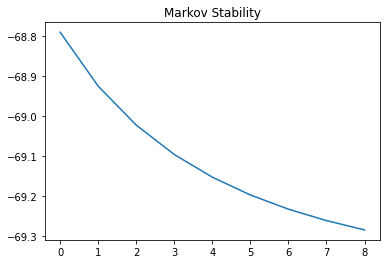

Number of partitions of K -clique reduction weighting the hyperedges:  8
-----------------------------------------------------------------------------------
Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.9933829345386087
Normalized Mutual Information (NMI): 0.9889869526275193
Conductance: 0.3186284302562185
Generalized Conductance: 1.3902074721693165
Number of partitions:  9
-----------------------------------------------------------------------------------
Weighted Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 1.0
Normalized Mutual Information (NMI): 1.0
Conductance: 0.31609590966605783
Generalized Conductance: 1.4228277365504574
Number of partitions:  9
-----------------------------------------------------------------------------------
Spectral clustering with number of community find with modularity
-----

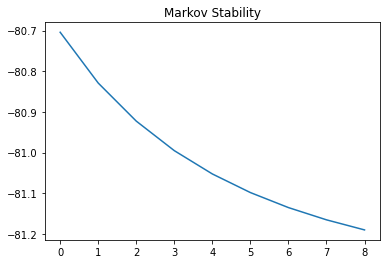

-----------------------------------------------------------------------------------
HyMMSBM with number of community of modularity
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.8099695380458246
Normalized Mutual Information (NMI): 0.7607605372651532
Conductance: 0.2707875692658721
Generalized Conductance: 0.8267768010465268


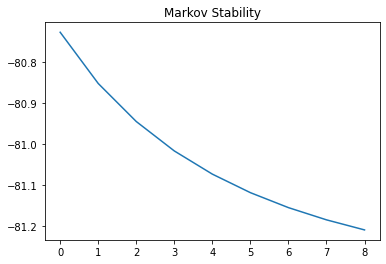

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


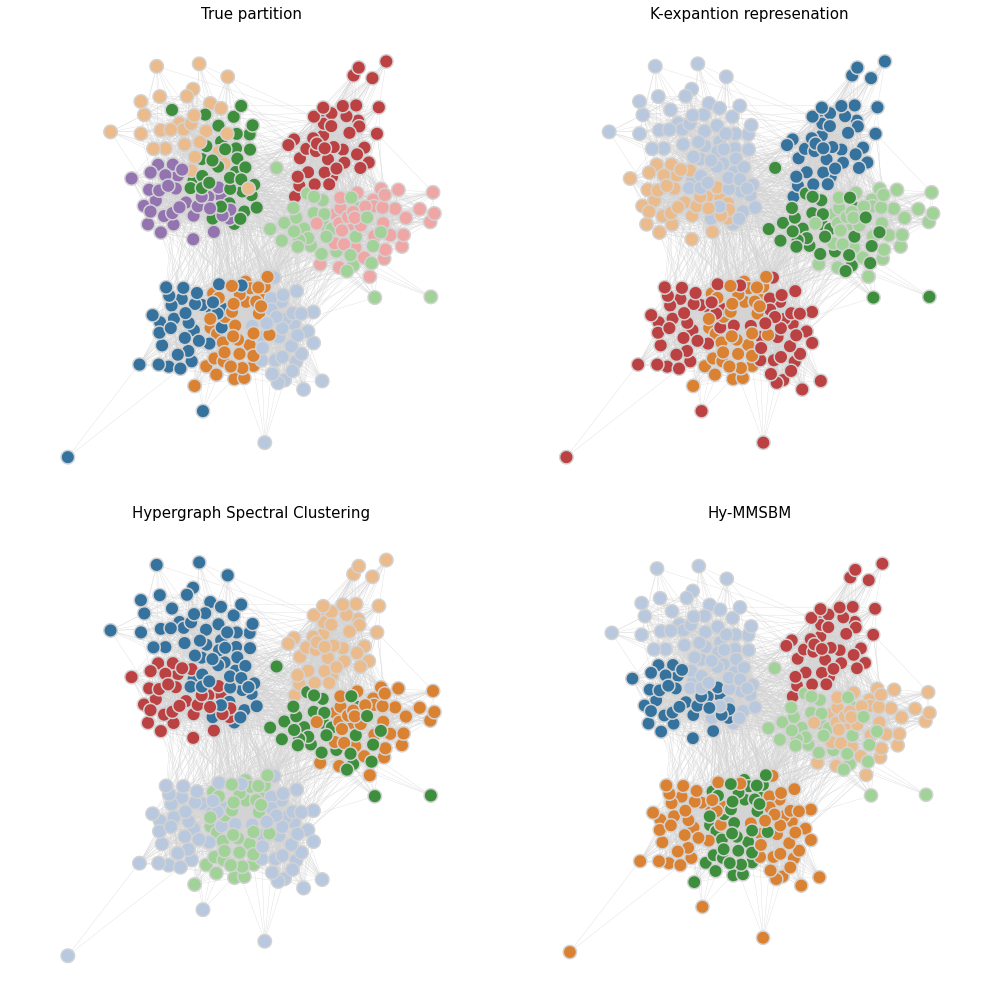

-----------------------------------------------------------------------------------
Spectral clustering with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.9866719641768288
Normalized Mutual Information (NMI): 0.9779805155411886
Conductance: 0.31976456706924045
Generalized Conductance: 1.2634477237769883


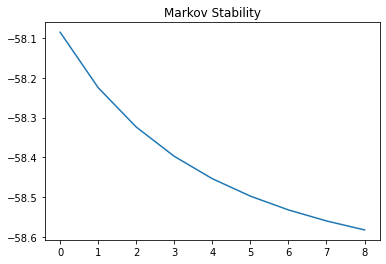

-----------------------------------------------------------------------------------
HyMMSBM with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.9809848649759395
Normalized Mutual Information (NMI): 0.9715249034714699
Conductance: 0.32177518592836374
Generalized Conductance: 1.4059647049677626


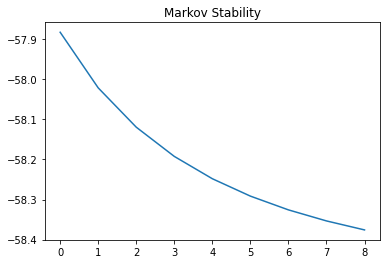

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


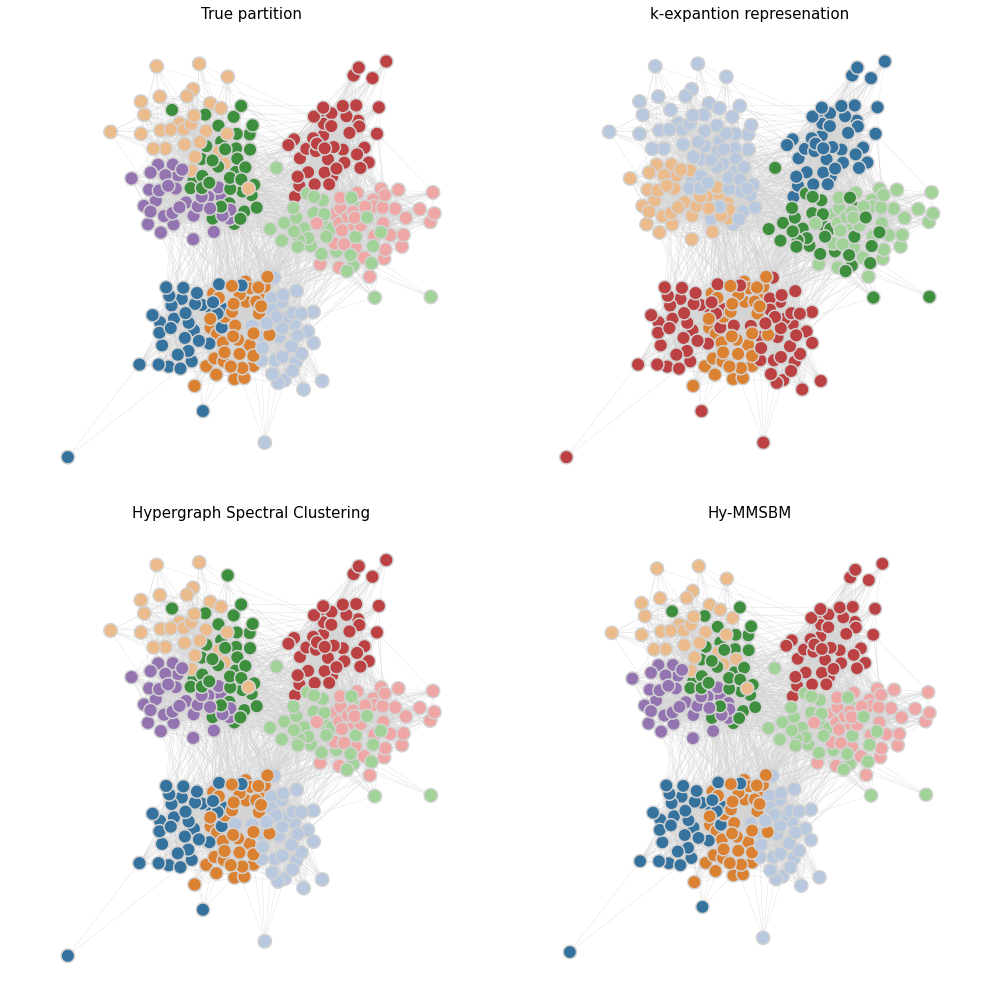

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


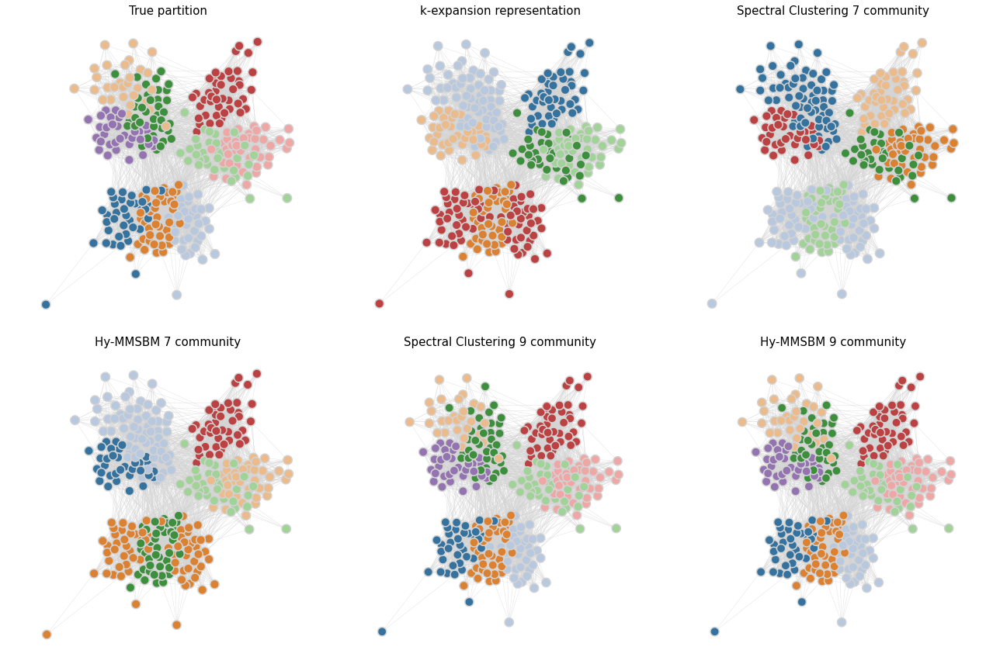

-----------------------------------------------------------------------------------
Spectral clustering choose of K
-----------------------------------------------------------------------------------
Number of communities:  3
Adjusted Rand Index (ARI): 0.37317292021062043
Normalized Mutual Information (NMI): 0.2624217562980404
Conductance: 0.13292168346024305
Generalized Conductance: 0.22182280076755234
Number of communities:  4
Adjusted Rand Index (ARI): 0.42897309139756873
Normalized Mutual Information (NMI): 0.41474385007173226
Conductance: 0.18159609317691788
Generalized Conductance: 0.35811993840223233
Number of communities:  5
Adjusted Rand Index (ARI): 0.5456982742874473
Normalized Mutual Information (NMI): 0.528584559891675
Conductance: 0.21036036050098988
Generalized Conductance: 0.4529436012789564
Number of communities:  6
Adjusted Rand Index (ARI): 0.6678938008588837
Normalized Mutual Information (NMI): 0.6429511410305886
Conductance: 0.2474871365881727
Generalized Conductan

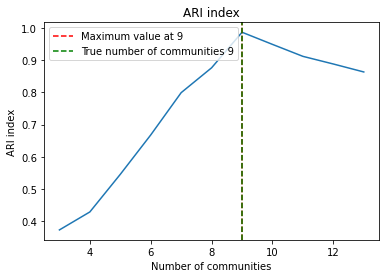

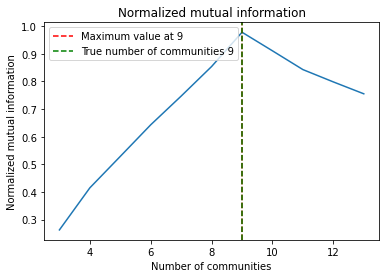

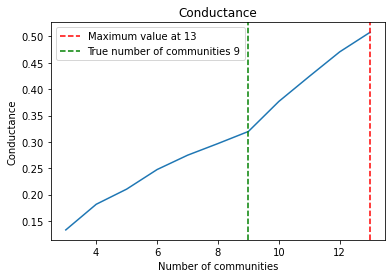

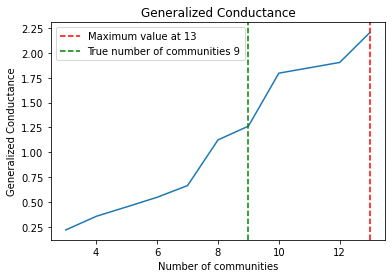

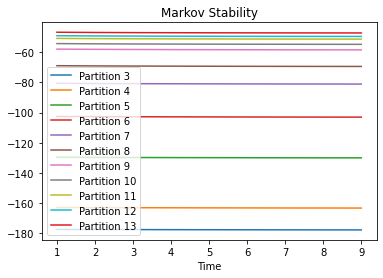

-----------------------------------------------------------------------------------
HyMMSBM choose of K
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.910170390315796
Normalized Mutual Information (NMI): 0.8934917575978537
Conductance: 0.3477791218488177
Generalized Conductance: 2.0059749219534484
Adjusted Rand Index (ARI): 0.9866659785881342
Normalized Mutual Information (NMI): 0.9780419468312405
Conductance: 0.31996146478611687
Generalized Conductance: 1.3685375066497047
Adjusted Rand Index (ARI): 0.9921321199261469
Normalized Mutual Information (NMI): 0.9888370059285725
Conductance: 0.3175849735852161
Generalized Conductance: 1.4247573968895797
Adjusted Rand Index (ARI): 0.9873403187854345
Normalized Mutual Information (NMI): 0.9794631734787919
Conductance: 0.32023897075216134
Generalized Conductance: 1.3899028712378534
Adjusted Rand Index (ARI): 0.9932835170101254
Normalized Mutual Information (NMI): 0.98896192368563

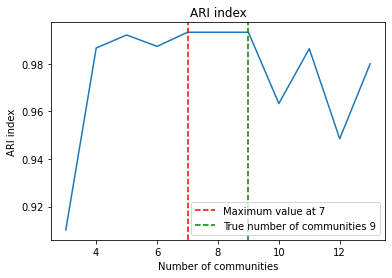

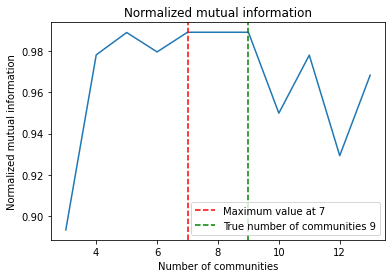

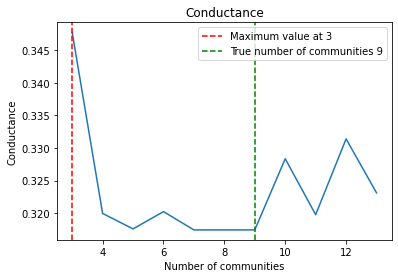

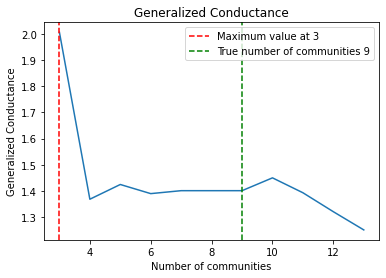

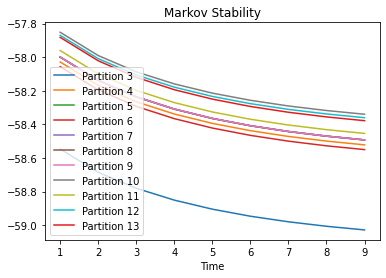

In [13]:
empirical_analysis_project(high_school, true_partition_high_school,
                           true_matrix_high_school, min_number, max_number, n_community,n_community)

## Workspace


In [14]:
file_path_workspace = '../data/workspace/workspace1.npz'
file_path_ground_truth_workspace = '../data/workspace/workspace1_meta.csv'
hyperedges_workspace = import_from_npz(file_path_workspace)

In [15]:
data = pd.read_csv(file_path_ground_truth_workspace)
true_community = {}
true_matrix = {}
for i in range(len(data)):
    if data['classID'][i] not in true_community:
        true_community[data['classID'][i]] = []
    true_community[data['classID'][i]].append(data['nodeID'][i])
    true_matrix[data['nodeID'][i]] = data['classID'][i]

number_community = len(true_community)
matrix = np.zeros((len(true_matrix), number_community))
for i in range(len(true_matrix)):
    matrix[i][true_matrix[i]-1] = 1

true_partition_workspace = true_community
true_matrix_workspace = matrix

In [16]:
number_community = true_matrix_workspace.shape[1]
print("True number of communities workspace: ", number_community)
min_number = 2
max_number = 8

True number of communities workspace:  5


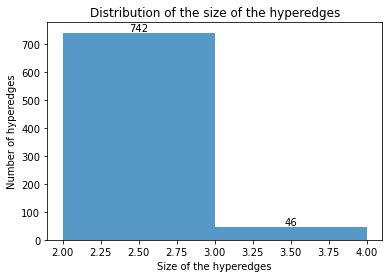

<Figure size 432x288 with 0 Axes>

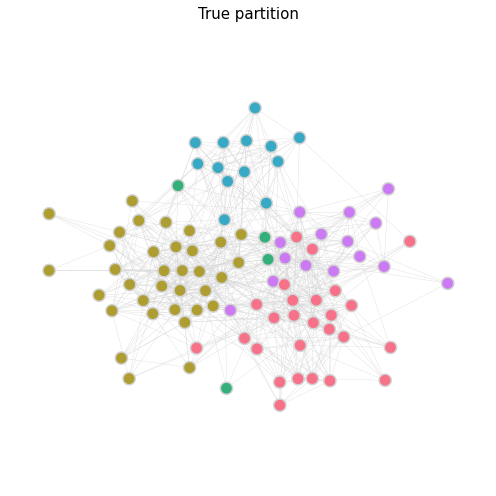

-----------------------------------------------------------------------------------
K -clique reduction
-----------------------------------------------------------------------------------


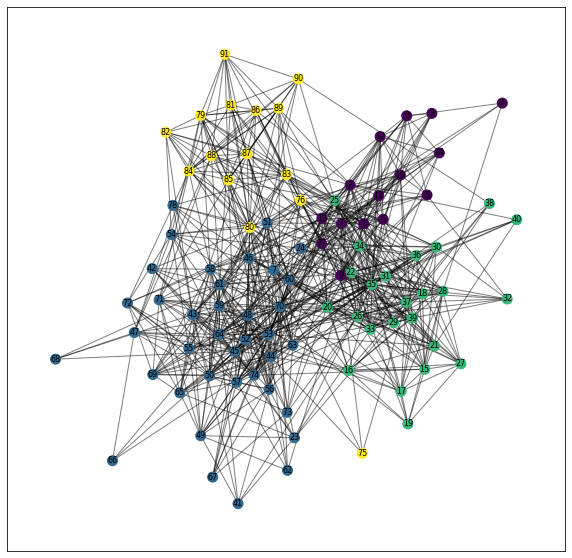

Adjusted Rand Index (ARI): 0.849997847055393
Normalized Mutual Information (NMI): 0.7470958766764417
Conductance: 0.3503175087945525
Generalized Conductance: 1.4022848625573205


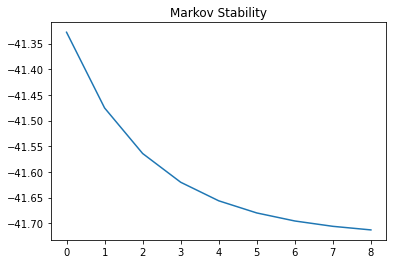

Number of partitions of K -clique reduction:  4
-----------------------------------------------------------------------------------
K -clique reduction weighting the hyperedges
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.8998028177647912
Normalized Mutual Information (NMI): 0.7806677749066437
Conductance: 0.3495273957856497
Generalized Conductance: 0.9604181702374786


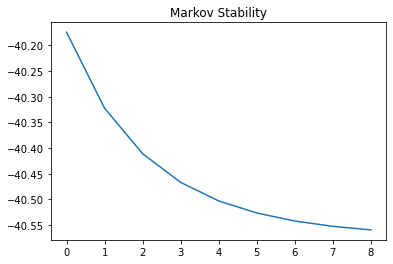

Number of partitions of K -clique reduction weighting the hyperedges:  4
-----------------------------------------------------------------------------------
Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.44447166721792786
Normalized Mutual Information (NMI): 0.4343875909792467
Conductance: 0.6739909308451832
Generalized Conductance: 1.7460856141138712
Number of partitions:  11
-----------------------------------------------------------------------------------
Weighted Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.48148326821884707
Normalized Mutual Information (NMI): 0.4048002244873714
Conductance: 0.7114267671271702
Generalized Conductance: 2.053432643392974
Number of partitions:  12
-----------------------------------------------------------------------------------
Spectral clustering with number of comm

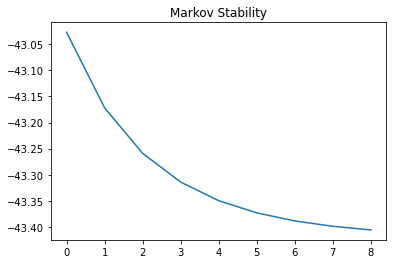

-----------------------------------------------------------------------------------
HyMMSBM with number of community of modularity
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.7853104768988751
Normalized Mutual Information (NMI): 0.6904533331281124
Conductance: 0.37780364842646874
Generalized Conductance: 2.418143573850111


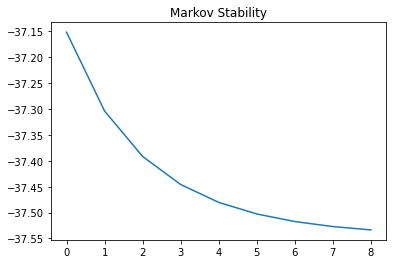

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


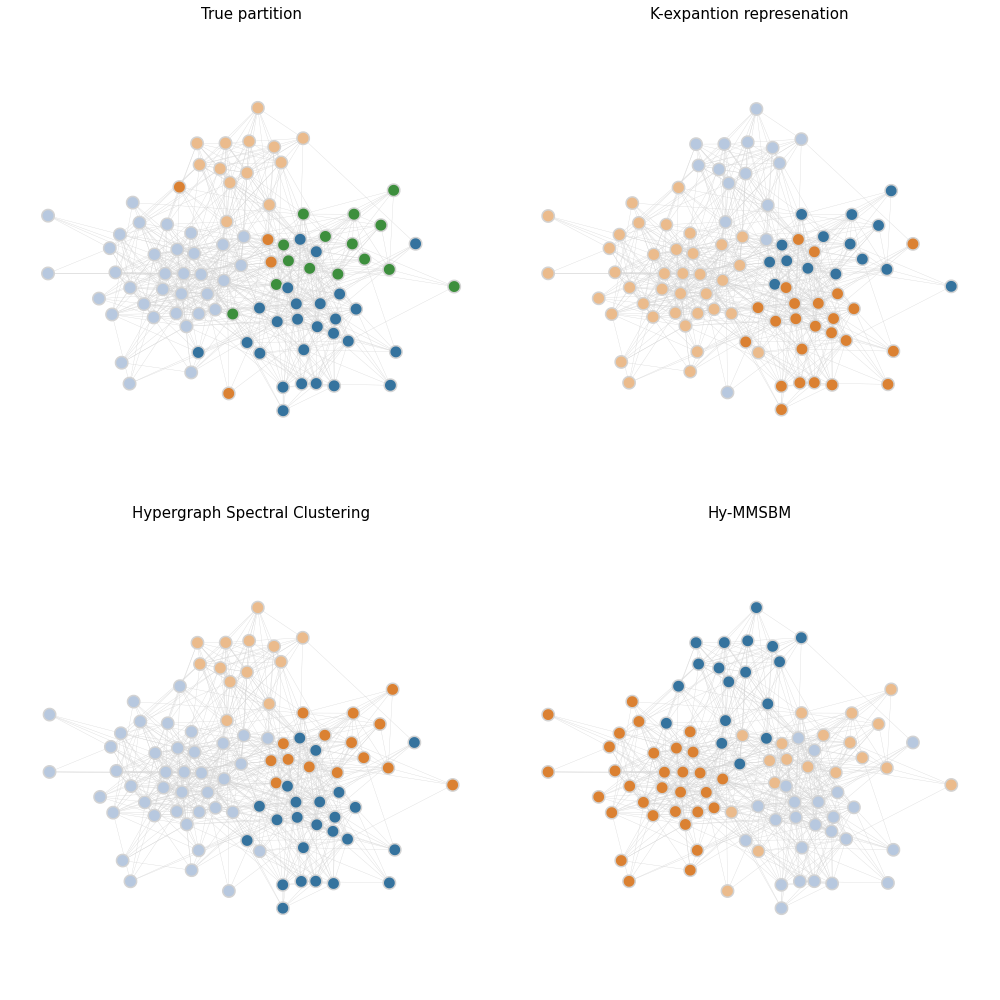

-----------------------------------------------------------------------------------
Spectral clustering with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.794789340131202
Normalized Mutual Information (NMI): 0.7008494590651632
Conductance: 0.43382926382710385
Generalized Conductance: 1.4677904970570403


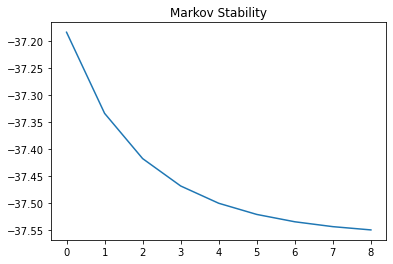

-----------------------------------------------------------------------------------
HyMMSBM with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.6728695780518514
Normalized Mutual Information (NMI): 0.6029568356773725
Conductance: 0.43774969124382024
Generalized Conductance: 1.4598274649940595


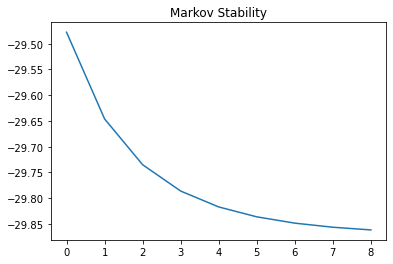

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


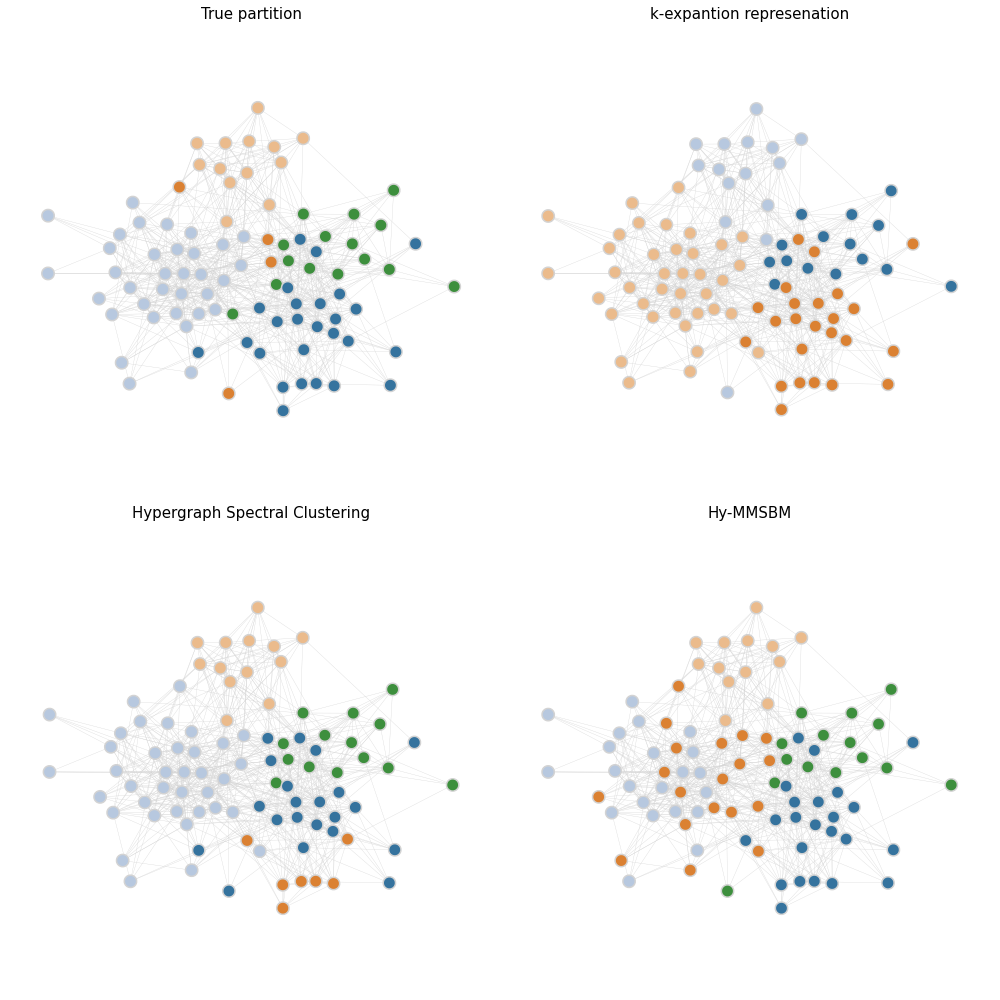

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


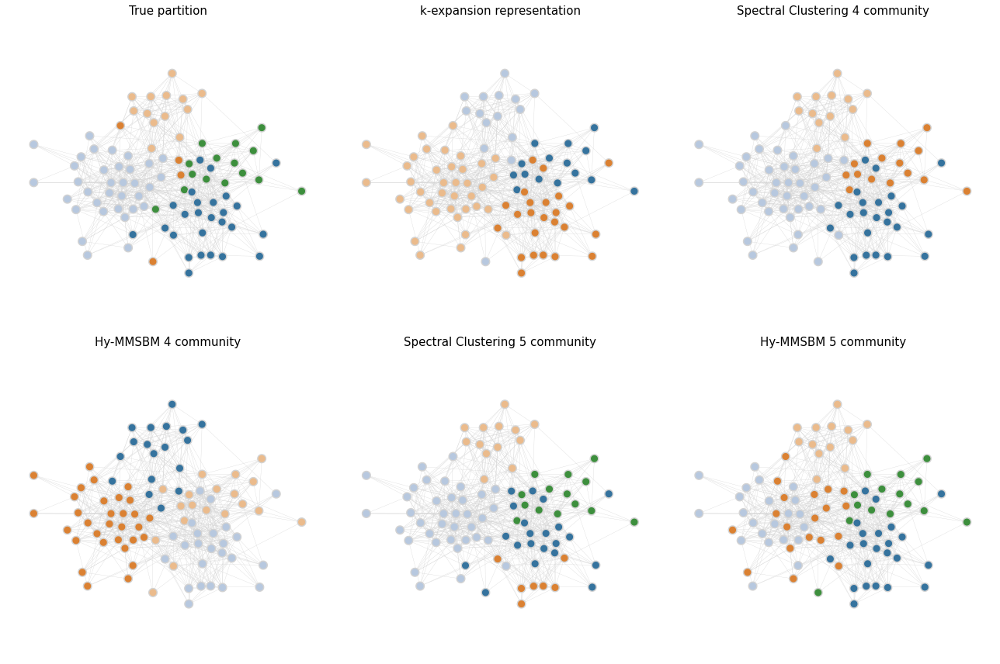

-----------------------------------------------------------------------------------
Spectral clustering choose of K
-----------------------------------------------------------------------------------
Number of communities:  2
Adjusted Rand Index (ARI): 0.46887639019973903
Normalized Mutual Information (NMI): 0.2841785796059393
Conductance: 0.21739130434782608
Generalized Conductance: 0.9717659963372294
Number of communities:  3
Adjusted Rand Index (ARI): 0.6691177473985321
Normalized Mutual Information (NMI): 0.5432634951366029
Conductance: 0.28116508569387966
Generalized Conductance: 0.9884486075557466
Number of communities:  4
Adjusted Rand Index (ARI): 0.824752646971458
Normalized Mutual Information (NMI): 0.7575468773478778
Conductance: 0.34667806387840094
Generalized Conductance: 1.44021814723915
Number of communities:  5
Adjusted Rand Index (ARI): 0.794789340131202
Normalized Mutual Information (NMI): 0.7008494590651632
Conductance: 0.43382926382710385
Generalized Conductance: 1.

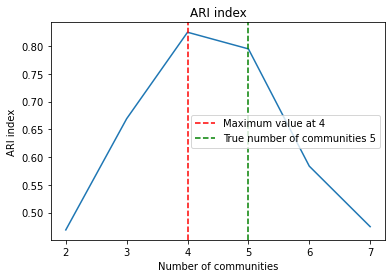

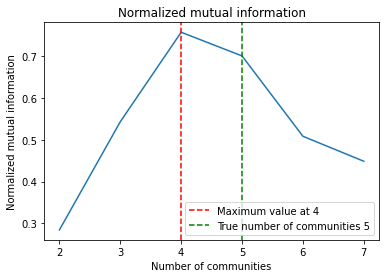

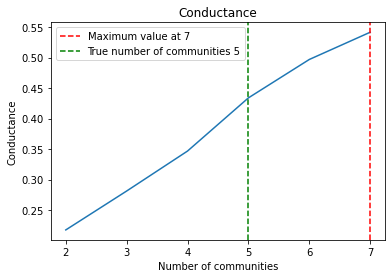

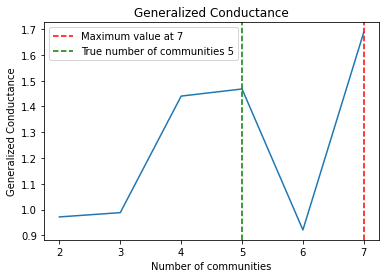

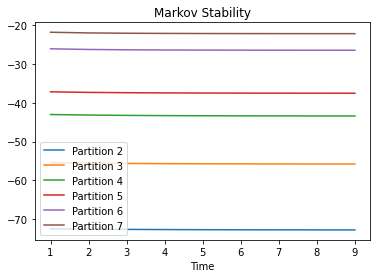

-----------------------------------------------------------------------------------
HyMMSBM choose of K
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.5466384894359382
Normalized Mutual Information (NMI): 0.5143688388630386
Conductance: 0.4655903300509058
Generalized Conductance: 1.1759285757491231
Adjusted Rand Index (ARI): 0.6827288582296659
Normalized Mutual Information (NMI): 0.609131139919637
Conductance: 0.43739845210181655
Generalized Conductance: 1.4804095876899317
Adjusted Rand Index (ARI): 0.664555535383001
Normalized Mutual Information (NMI): 0.5975395957555799
Conductance: 0.4407147582516119
Generalized Conductance: 1.501045316058225
Adjusted Rand Index (ARI): 0.6766284246085829
Normalized Mutual Information (NMI): 0.5889921050279349
Conductance: 0.4511250679229547
Generalized Conductance: 2.632882617505229
Adjusted Rand Index (ARI): 0.7668266628171352
Normalized Mutual Information (NMI): 0.6633284032472876
C

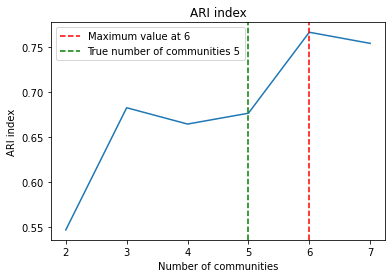

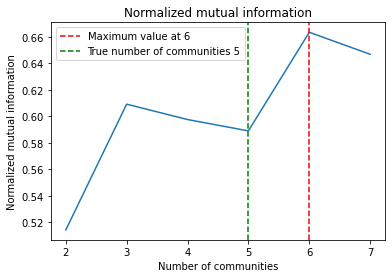

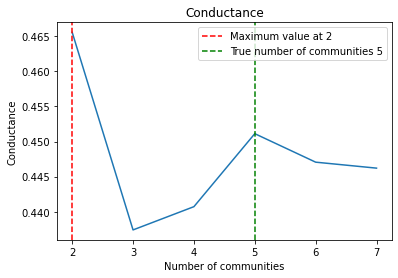

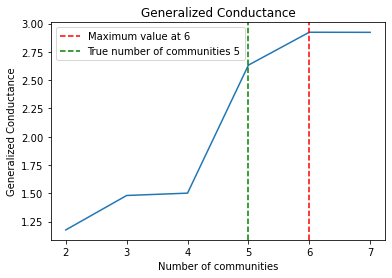

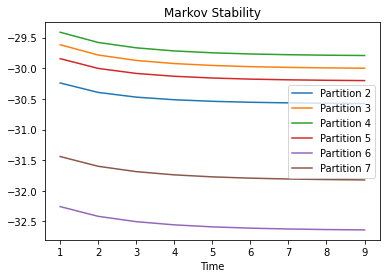

In [17]:
empirical_analysis_project(hyperedges_workspace, true_partition_workspace,
                           true_matrix_workspace, min_number, max_number, number_community,number_community)

### Senate Commities


In [18]:
file_path_senate_committees = data_path + \
    "senate-committees/hyperedges-senate-committees.txt"

file_true_partition_senate_committees_old = data_path + \
    "senate-committees/node-labels-senate-committees.txt"
file_true_partition_senate_committees = data_path + \
    "senate-committees/node-labels-senate-committees_new.txt"

with open(file_true_partition_senate_committees_old, "r", encoding="utf-8") as file:
    content = file.read()

# Replace '਱' with '0' and 'ਲ' with '1'
binary_content = content.replace("਱", "0").replace("ਲ", "1")

# Write the binary output to a new file
with open(file_true_partition_senate_committees, "w", encoding="utf-8") as file:
    file.write(binary_content)


true_partition_senate_committees, true_matrix_senate_committees = import_txt_true_one_community(
    file_true_partition_senate_committees)
senate_committees = import_txt_comma_hypergraph(file_path_senate_committees)

print("True number of communities senate committiees: ",
      true_matrix_senate_committees.shape[1])
number_community = true_matrix_senate_committees.shape[1]

True number of communities senate committiees:  2


In [19]:
min_number, max_number = 2,  7

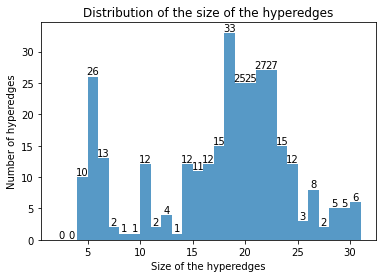

<Figure size 432x288 with 0 Axes>

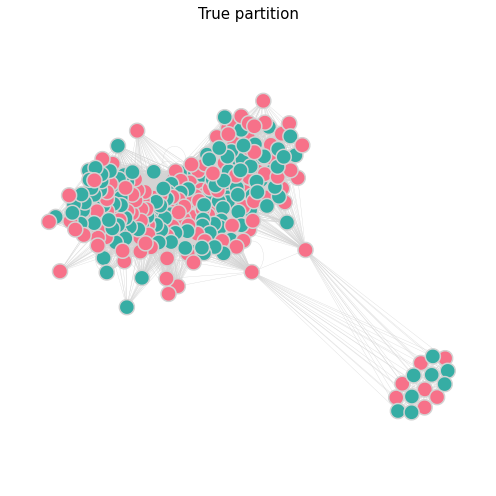

-----------------------------------------------------------------------------------
K -clique reduction
-----------------------------------------------------------------------------------


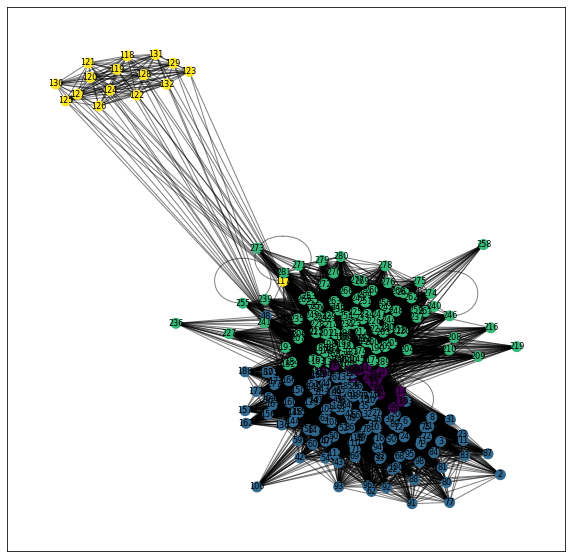

Adjusted Rand Index (ARI): -0.0032573801295609508
Normalized Mutual Information (NMI): 0.000619295199173115
Conductance: 0.44331947527484084
Generalized Conductance: 85.03493609110305


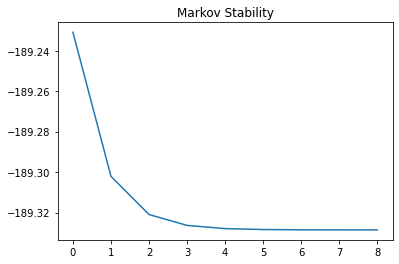

Number of partitions of K -clique reduction:  4
-----------------------------------------------------------------------------------
K -clique reduction weighting the hyperedges
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.004556987527968671
Normalized Mutual Information (NMI): 0.0004991240204201045
Conductance: 0.5488511437652002
Generalized Conductance: 83.8561000801033


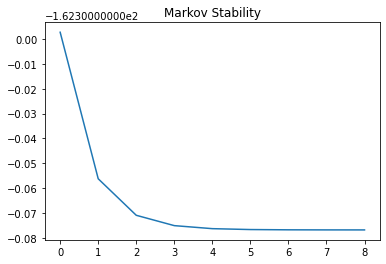

Number of partitions of K -clique reduction weighting the hyperedges:  5
-----------------------------------------------------------------------------------
Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.002764192309096743
Normalized Mutual Information (NMI): 0.0023832281705509265
Conductance: 0.676627383853875
Generalized Conductance: 126.61143783262014
Number of partitions:  8
-----------------------------------------------------------------------------------
Weighted Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0037119047290547053
Normalized Mutual Information (NMI): 0.0018685926433212375
Conductance: 0.7006325139826148
Generalized Conductance: 150.755924301618
Number of partitions:  8
-----------------------------------------------------------------------------------
Spectral clustering with number 

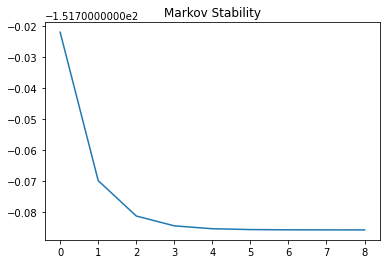

-----------------------------------------------------------------------------------
HyMMSBM with number of community of modularity
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.010689416033745777
Normalized Mutual Information (NMI): 0.008199240847917766
Conductance: 0.6945143131299727
Generalized Conductance: 95.28203995052237


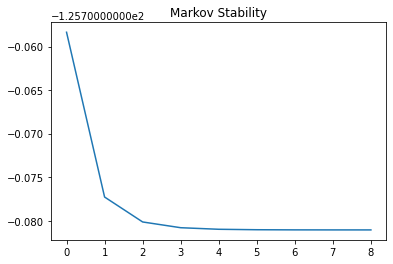

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


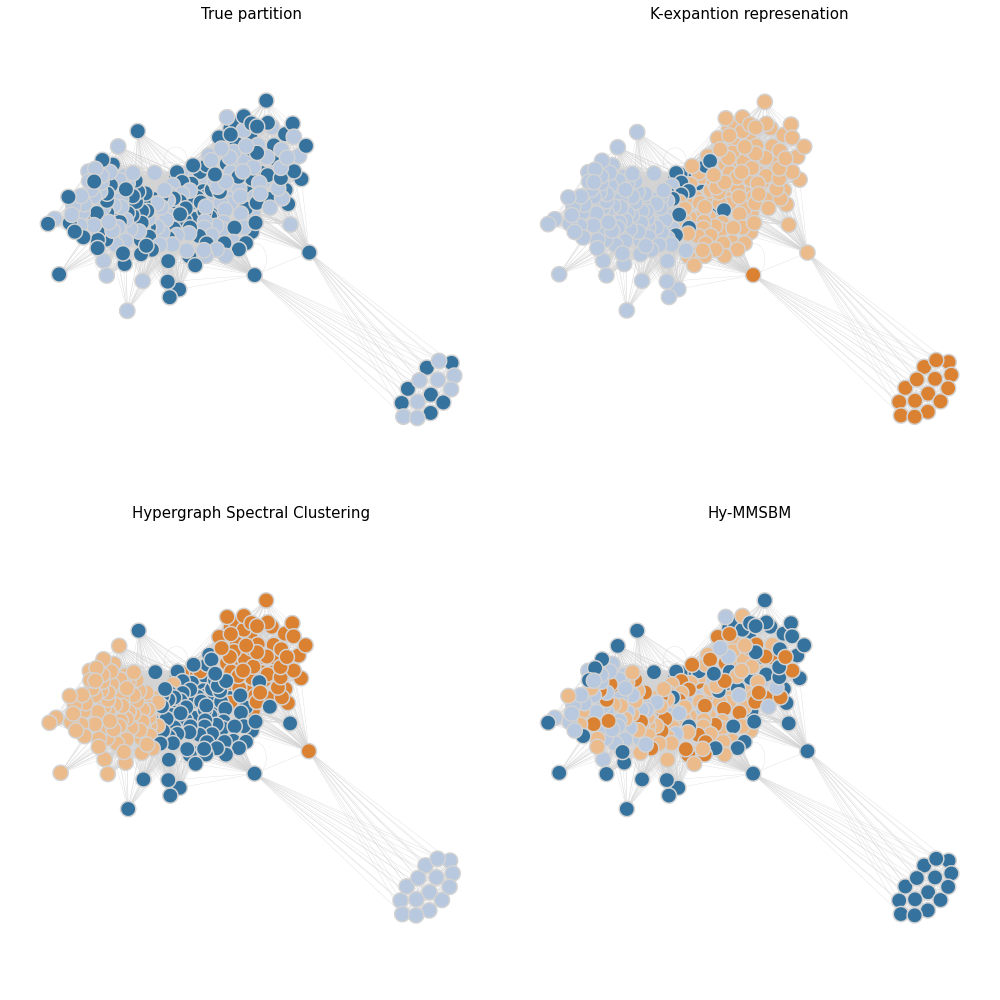

-----------------------------------------------------------------------------------
Spectral clustering with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0007576030294211492
Normalized Mutual Information (NMI): 0.00014395996521765825
Conductance: 0.125
Generalized Conductance: 0.23774513596270708


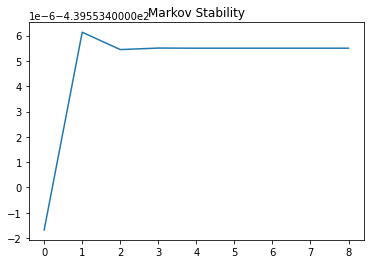

-----------------------------------------------------------------------------------
HyMMSBM with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.005254279594707098
Normalized Mutual Information (NMI): 0.008451413386316973
Conductance: 0.7376675220986598
Generalized Conductance: 68.73822867930105


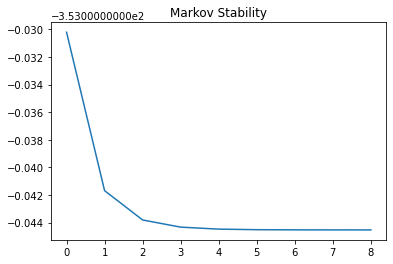

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


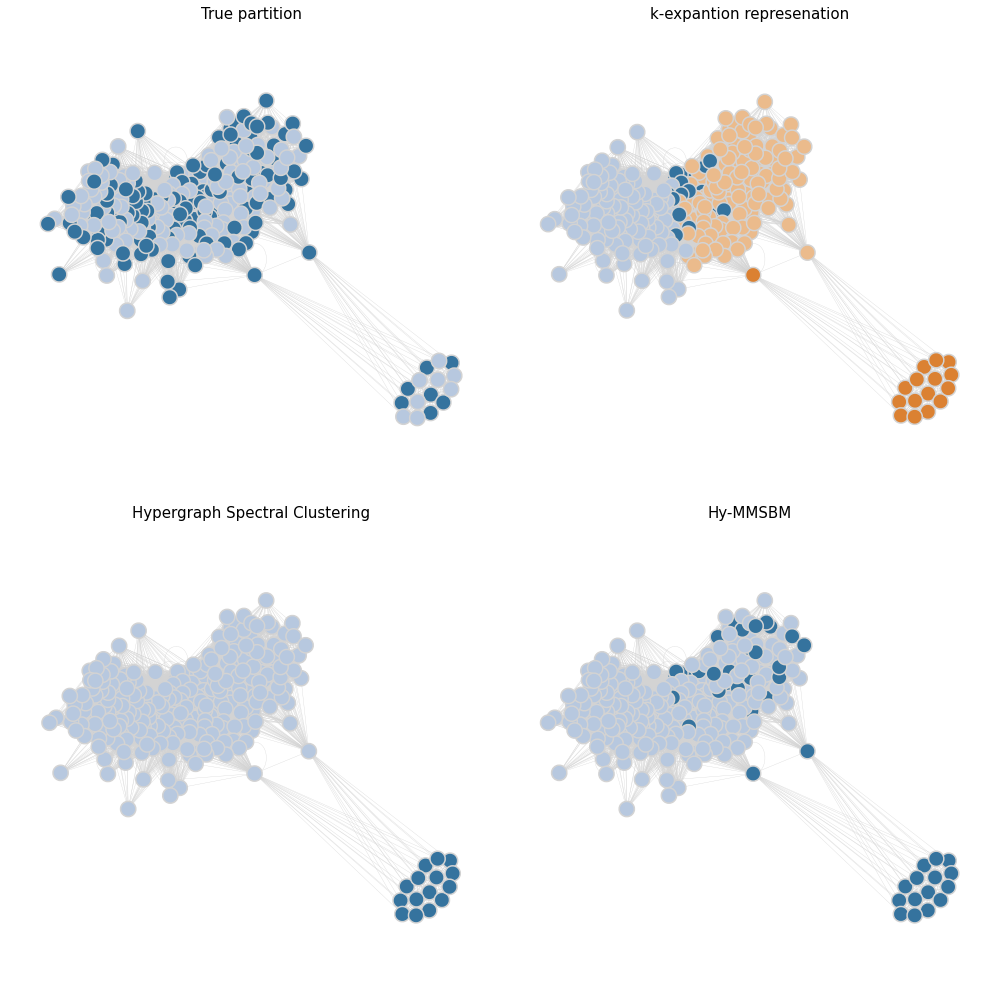

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


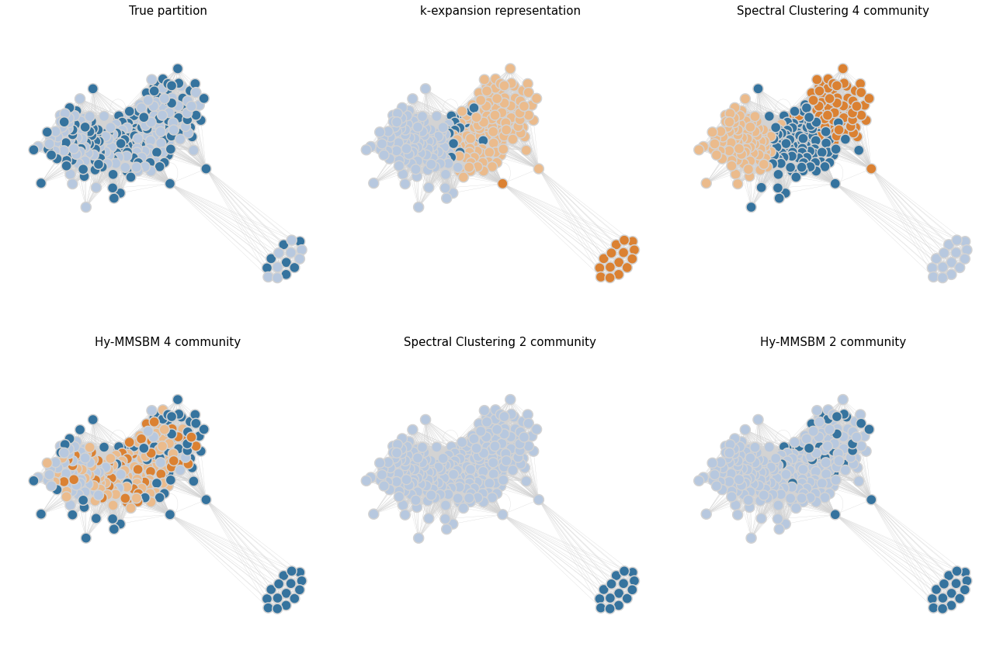

-----------------------------------------------------------------------------------
Different assortative
-----------------------------------------------------------------------------------


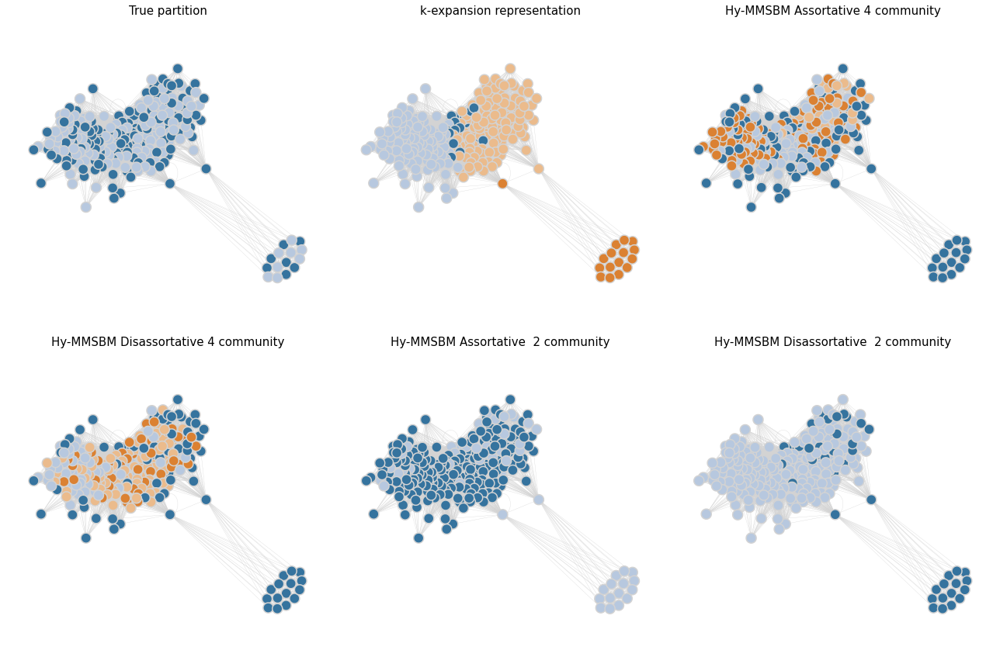

-----------------------------------------------------------------------------------
Spectral clustering choose of K
-----------------------------------------------------------------------------------
Number of communities:  2
Adjusted Rand Index (ARI): -0.0007576030294211492
Normalized Mutual Information (NMI): 0.00014395996521765825
Conductance: 0.125
Generalized Conductance: 0.23774513596270708
Number of communities:  3
Adjusted Rand Index (ARI): -0.0023597130834784
Normalized Mutual Information (NMI): 0.0010542725728425147
Conductance: 0.23835520099332327
Generalized Conductance: 26.880765536318265
Number of communities:  4
Adjusted Rand Index (ARI): -0.004708403632658981
Normalized Mutual Information (NMI): 0.00016139739752960252
Conductance: 0.36190729910692176
Generalized Conductance: 53.825661267009416
Number of communities:  5
Adjusted Rand Index (ARI): -0.0033060031337013673
Normalized Mutual Information (NMI): 0.0015188907727733245
Conductance: 0.4820206157357367
Generalized 

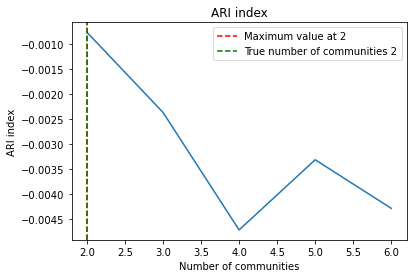

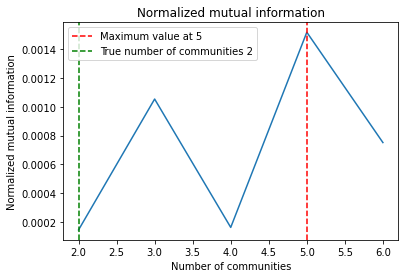

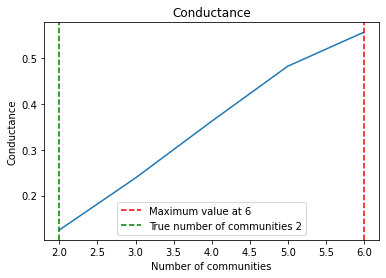

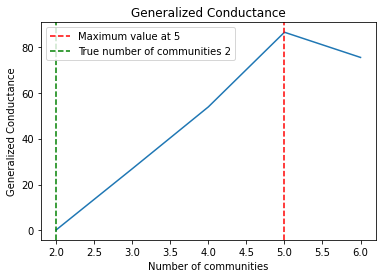

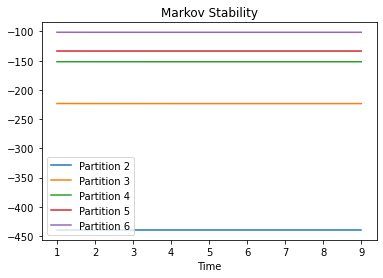

-----------------------------------------------------------------------------------
HyMMSBM choose of K
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.01733311309190756
Normalized Mutual Information (NMI): 0.017594097971828856
Conductance: 0.7392544306376044
Generalized Conductance: 82.53440893300666
Adjusted Rand Index (ARI): 0.0019563892705794133
Normalized Mutual Information (NMI): 0.005472312878601252
Conductance: 0.825089605734767
Generalized Conductance: 79.76352179450308
Adjusted Rand Index (ARI): 0.0010293921078651678
Normalized Mutual Information (NMI): 0.0032406908014577275
Conductance: 0.7693269952464348
Generalized Conductance: 63.215521423178735
Adjusted Rand Index (ARI): 0.015795188174300787
Normalized Mutual Information (NMI): 0.01860767462229995
Conductance: 0.7877641824249165
Generalized Conductance: 83.20180365218496
Adjusted Rand Index (ARI): 0.01733311309190756
Normalized Mutual Information (NMI): 0.0

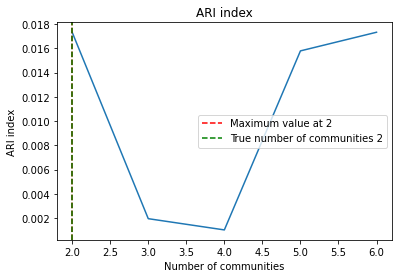

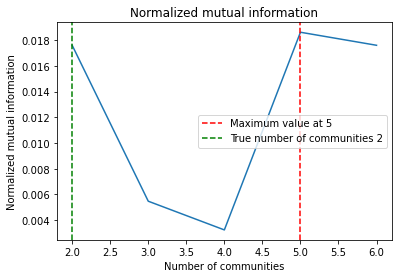

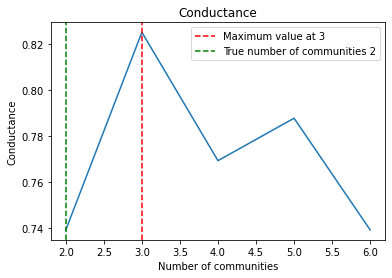

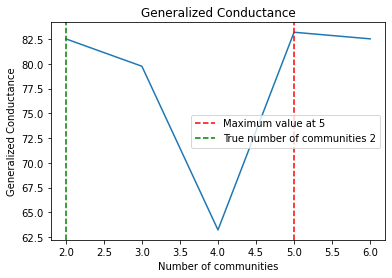

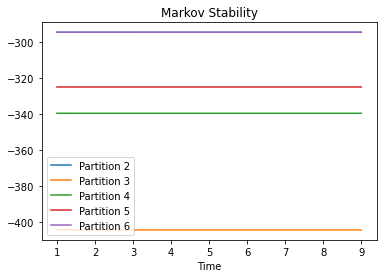

In [20]:
empirical_analysis_project(senate_committees, true_partition_senate_committees,
                           true_matrix_senate_committees, min_number, max_number, true_matrix_senate_committees.shape[1],number_community,assortative=False)

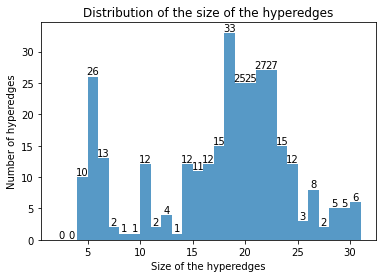

<Figure size 432x288 with 0 Axes>

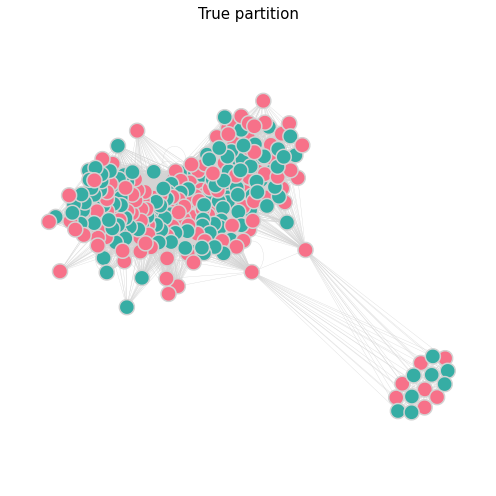

-----------------------------------------------------------------------------------
K -clique reduction
-----------------------------------------------------------------------------------


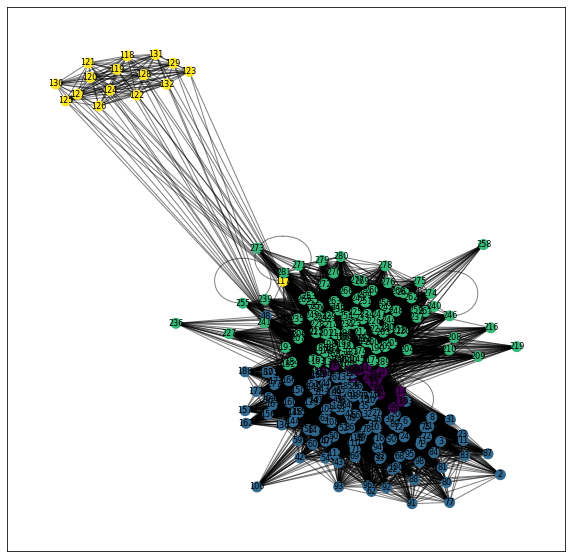

Adjusted Rand Index (ARI): -0.0032573801295609508
Normalized Mutual Information (NMI): 0.000619295199173115
Conductance: 0.44331947527484084
Generalized Conductance: 85.03493609110305


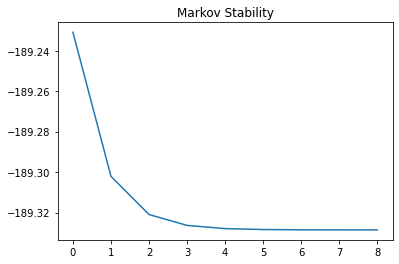

Number of partitions of K -clique reduction:  4
-----------------------------------------------------------------------------------
K -clique reduction weighting the hyperedges
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.004556987527968671
Normalized Mutual Information (NMI): 0.0004991240204201045
Conductance: 0.5488511437652002
Generalized Conductance: 83.8561000801033


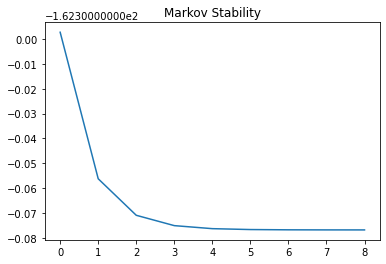

Number of partitions of K -clique reduction weighting the hyperedges:  5
-----------------------------------------------------------------------------------
Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.002764192309096743
Normalized Mutual Information (NMI): 0.0023832281705509265
Conductance: 0.676627383853875
Generalized Conductance: 126.61143783262014
Number of partitions:  8
-----------------------------------------------------------------------------------
Weighted Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0037119047290547053
Normalized Mutual Information (NMI): 0.0018685926433212375
Conductance: 0.7006325139826148
Generalized Conductance: 150.755924301618
Number of partitions:  8
-----------------------------------------------------------------------------------
Spectral clustering with number 

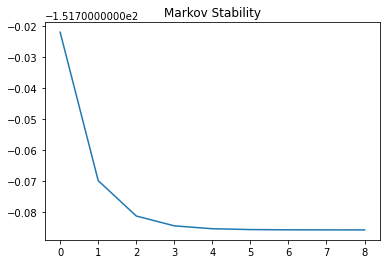

-----------------------------------------------------------------------------------
HyMMSBM with number of community of modularity
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.013512324319623773
Normalized Mutual Information (NMI): 0.011869937018168025
Conductance: 0.7027127327388516
Generalized Conductance: 93.71230238277148


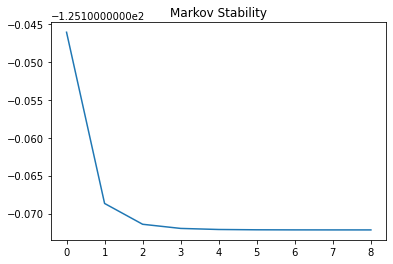

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


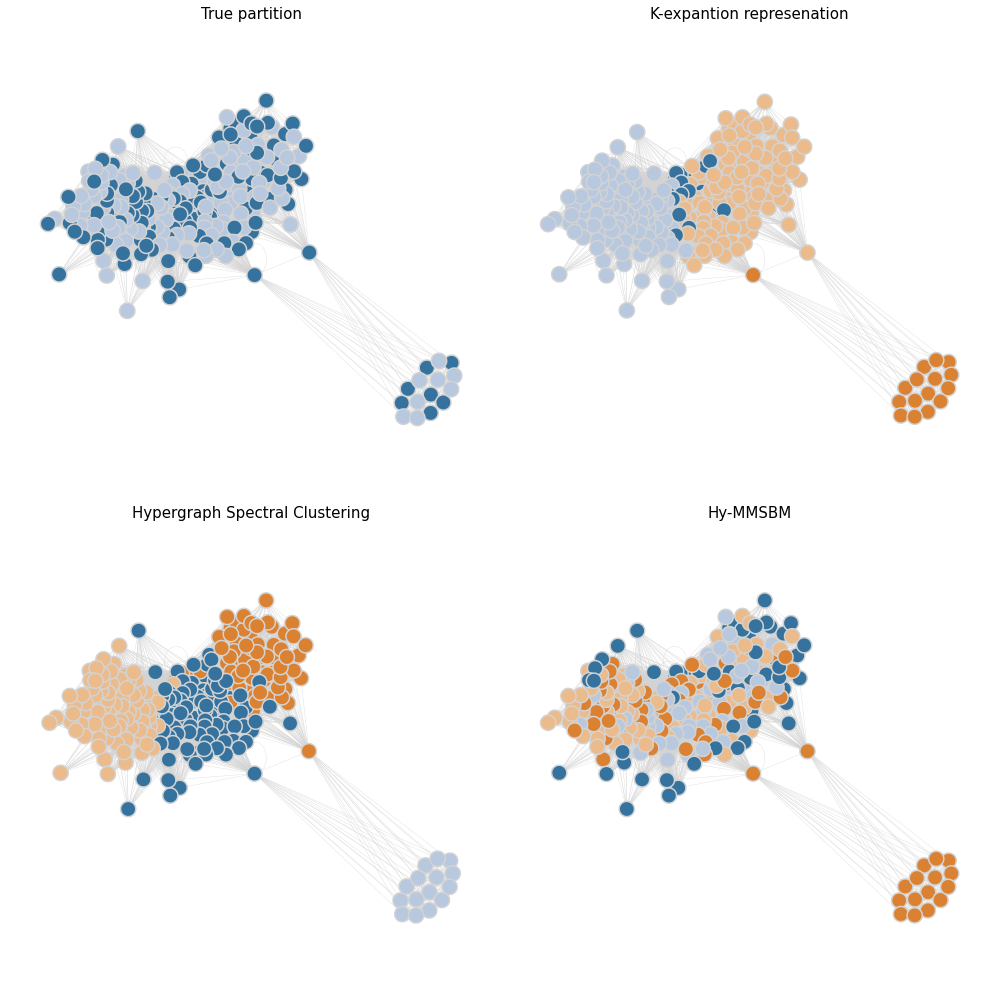

-----------------------------------------------------------------------------------
Spectral clustering with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0007576030294211492
Normalized Mutual Information (NMI): 0.00014395996521765825
Conductance: 0.125
Generalized Conductance: 0.23774513596270708


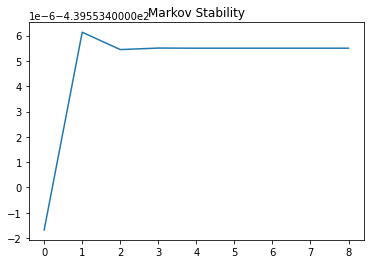

-----------------------------------------------------------------------------------
HyMMSBM with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.003110282935573156
Normalized Mutual Information (NMI): 0.004877812056864085
Conductance: 0.7057913730881594
Generalized Conductance: 70.17997704462883


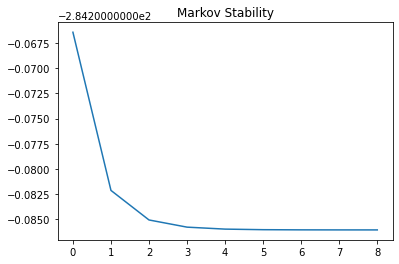

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


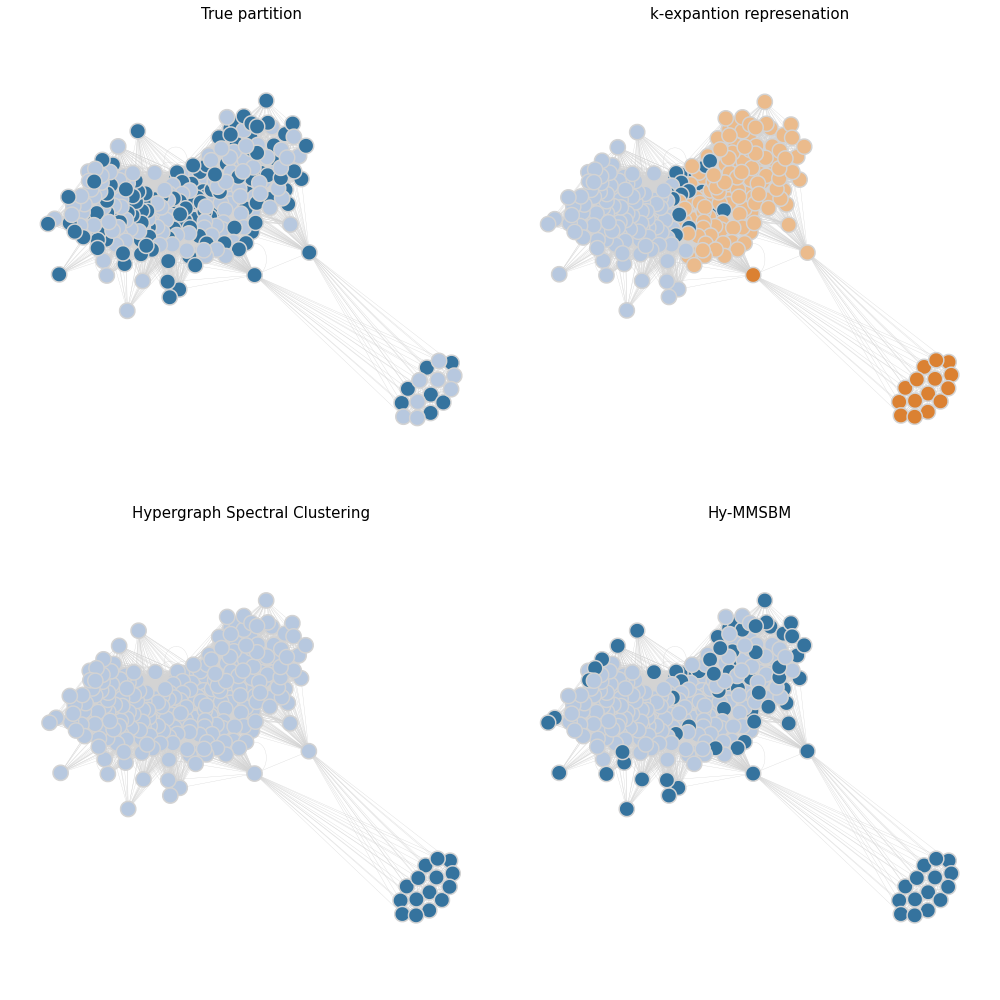

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


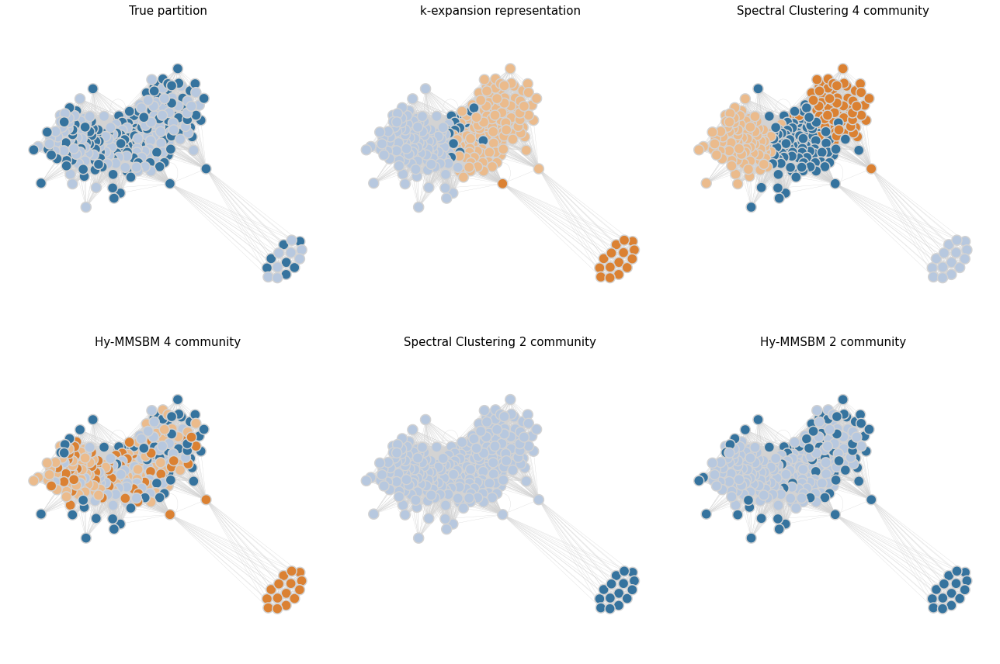

-----------------------------------------------------------------------------------
Spectral clustering choose of K
-----------------------------------------------------------------------------------
Number of communities:  2
Adjusted Rand Index (ARI): -0.0007576030294211492
Normalized Mutual Information (NMI): 0.00014395996521765825
Conductance: 0.125
Generalized Conductance: 0.23774513596270708
Number of communities:  3
Adjusted Rand Index (ARI): -0.0023597130834784
Normalized Mutual Information (NMI): 0.0010542725728425147
Conductance: 0.23835520099332327
Generalized Conductance: 26.880765536318265
Number of communities:  4
Adjusted Rand Index (ARI): -0.004708403632658981
Normalized Mutual Information (NMI): 0.00016139739752960252
Conductance: 0.36190729910692176
Generalized Conductance: 53.825661267009416
Number of communities:  5
Adjusted Rand Index (ARI): -0.0033060031337013673
Normalized Mutual Information (NMI): 0.0015188907727733245
Conductance: 0.4820206157357367
Generalized 

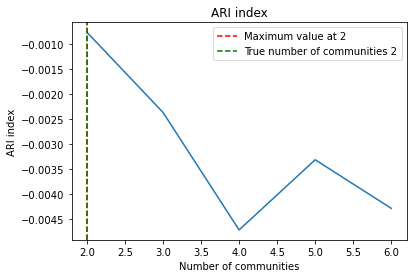

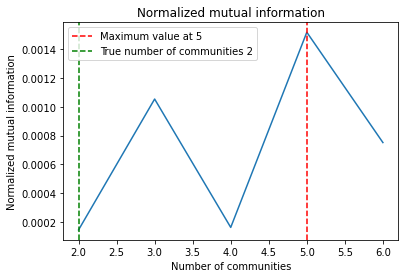

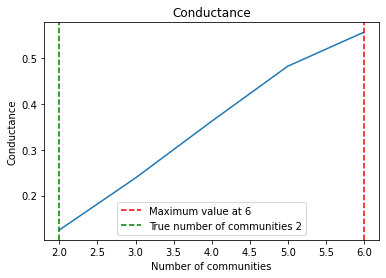

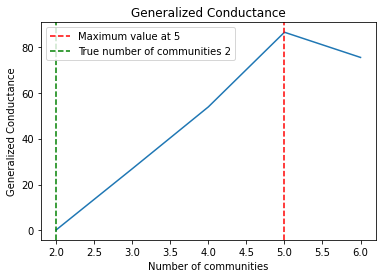

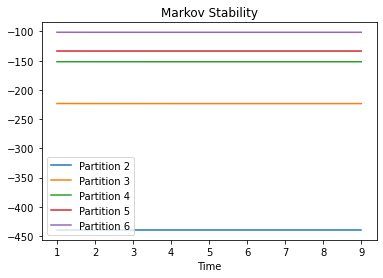

-----------------------------------------------------------------------------------
HyMMSBM choose of K
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.017733607266346763
Normalized Mutual Information (NMI): 0.020469484476110154
Conductance: 0.78894251864853
Generalized Conductance: 78.2903311058298
Adjusted Rand Index (ARI): 0.0028441441835636515
Normalized Mutual Information (NMI): 0.0052443767179163004
Conductance: 0.7195238095238096
Generalized Conductance: 76.07162893446736
Adjusted Rand Index (ARI): 0.01733311309190756
Normalized Mutual Information (NMI): 0.017594097971828856
Conductance: 0.7392544306376044
Generalized Conductance: 82.53440893300666
Adjusted Rand Index (ARI): 0.019379209452383365
Normalized Mutual Information (NMI): 0.01931059935385778
Conductance: 0.7409493161705552
Generalized Conductance: 77.6259900087349
Adjusted Rand Index (ARI): 0.0021801710472544155
Normalized Mutual Information (NMI): 0.0047

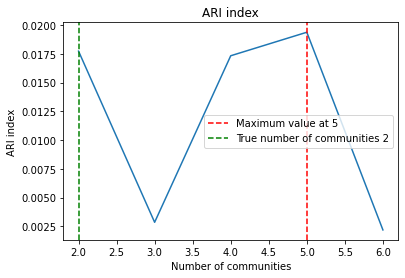

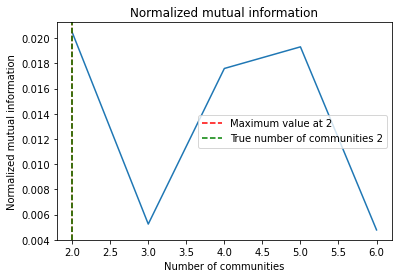

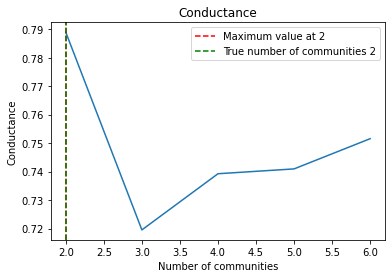

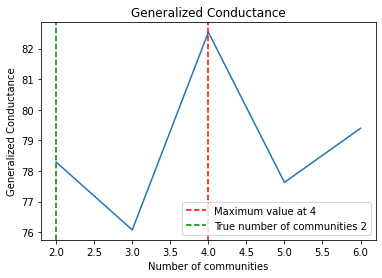

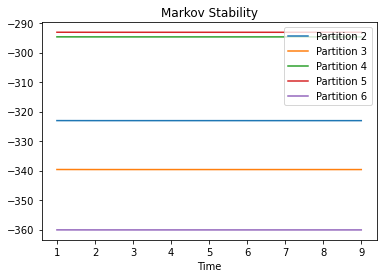

In [21]:
empirical_analysis_project(senate_committees, true_partition_senate_committees,
                           true_matrix_senate_committees, min_number, max_number, true_matrix_senate_committees.shape[1],number_community)

### Congress Committies


In [22]:
file_congress_committies = data_path + \
    "congress-committees/house_committees.csv"
data = pd.read_csv(file_congress_committies)

# Combine 'Column1' and 'Column2' into a new column 'Combined'
data['committeeID'] = data['committee'].astype(
    str) + data['session'].astype(str)

file_congress_committies_new = data_path + \
    "congress-committees/house_committees_new.csv"
# Save the DataFrame to CSV
data.to_csv(file_congress_committies_new, index=False)

In [23]:
import csv
from collections import defaultdict


committee_house = defaultdict(list)

with open(file_congress_committies_new, mode='r') as file:
    reader = csv.DictReader(file)
    for row in reader:
        committee = row['committeeID']
        senator_id = row['new_id']
        committee_house[committee].append(int(senator_id)-1)

# Convert dictionary values to a list of lists
committee_house_hyperedges = list(committee_house.values())

In [24]:
committee_house_hyperedges = [ x for x in committee_house_hyperedges if len(x) > 1]

In [25]:
true_community = {}
true_matrix = {}
for i in range(len(data)):
    if data['party'][i] not in true_community:
        true_community[data['party'][i]] = []
    true_community[data['party'][i]].append(data['new_id'][i]-1)
    true_matrix[data['new_id'][i]-1] = data['party'][i]

number_community = len(true_community)
matrix = np.zeros((len(true_matrix), number_community))

for i in range(len(true_matrix)):
    matrix[i][true_matrix[i]-1] = 1

true_partition_congress_committies = true_community
true_matrix_congress_committies = matrix

In [26]:
print("True number of communities congress committies: ", number_community)
min_number = 2
max_number = 4

True number of communities congress committies:  2


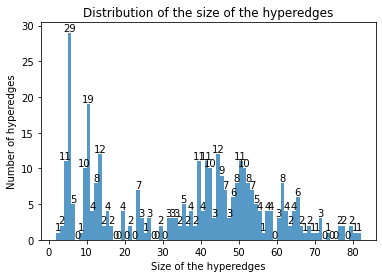

<Figure size 432x288 with 0 Axes>

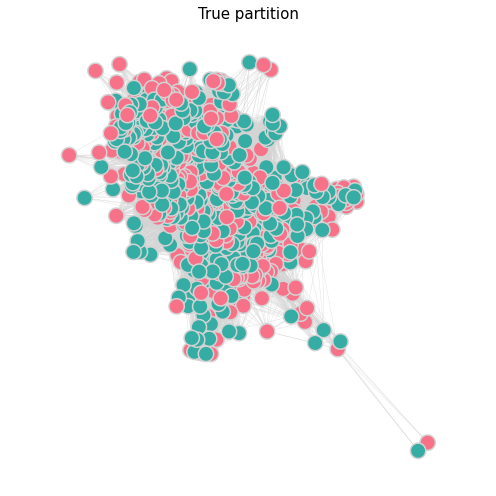

-----------------------------------------------------------------------------------
K -clique reduction
-----------------------------------------------------------------------------------


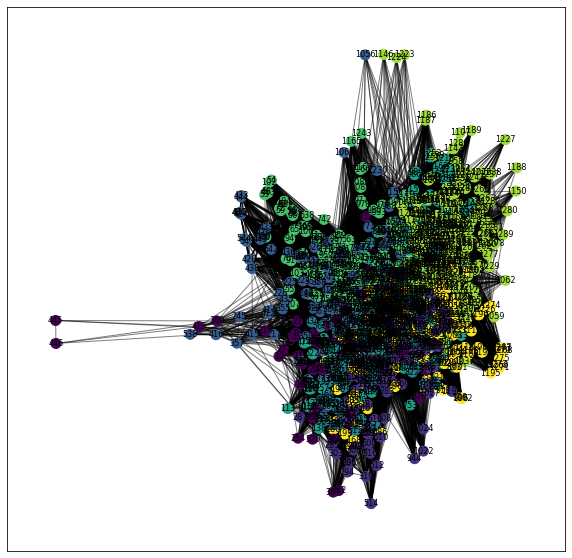

Adjusted Rand Index (ARI): 0.0014717171655690177
Normalized Mutual Information (NMI): 0.0014811227383791806
Conductance: 0.6118208939788705
Generalized Conductance: 628.1200961628512


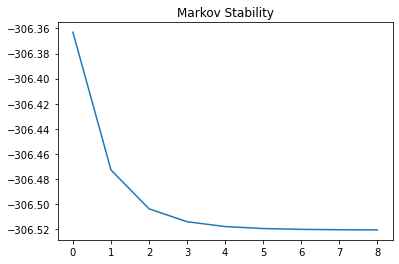

Number of partitions of K -clique reduction:  8
-----------------------------------------------------------------------------------
K -clique reduction weighting the hyperedges
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0009713022455947475
Normalized Mutual Information (NMI): 0.0008805635339436184
Conductance: 0.6941277768612654
Generalized Conductance: 854.7874325368095


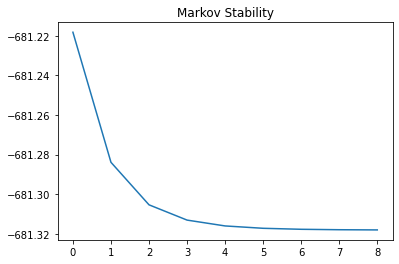

Number of partitions of K -clique reduction weighting the hyperedges:  7
-----------------------------------------------------------------------------------
Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.002597030730409162
Normalized Mutual Information (NMI): 0.0025490359066251914
Conductance: 0.7252234328981401
Generalized Conductance: 901.0632879424186
Number of partitions:  11
-----------------------------------------------------------------------------------
Weighted Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.001553386849610441
Normalized Mutual Information (NMI): 0.0026943043874938905
Conductance: 0.9053700111853197
Generalized Conductance: 1040.212830499869
Number of partitions:  11
-----------------------------------------------------------------------------------
Spectral clustering with number

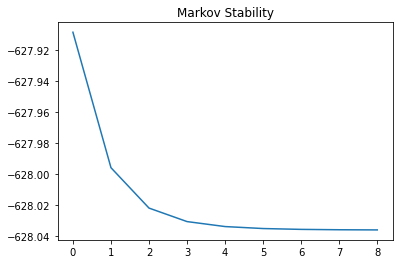

-----------------------------------------------------------------------------------
HyMMSBM with number of community of modularity
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0008227511267454962
Normalized Mutual Information (NMI): 0.0007775089760495455
Conductance: 0.7842480533265735
Generalized Conductance: 748.6587192908681


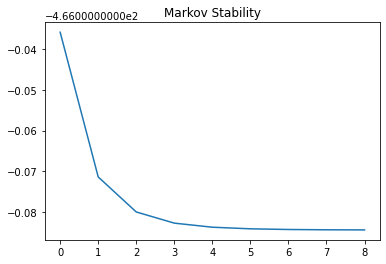

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


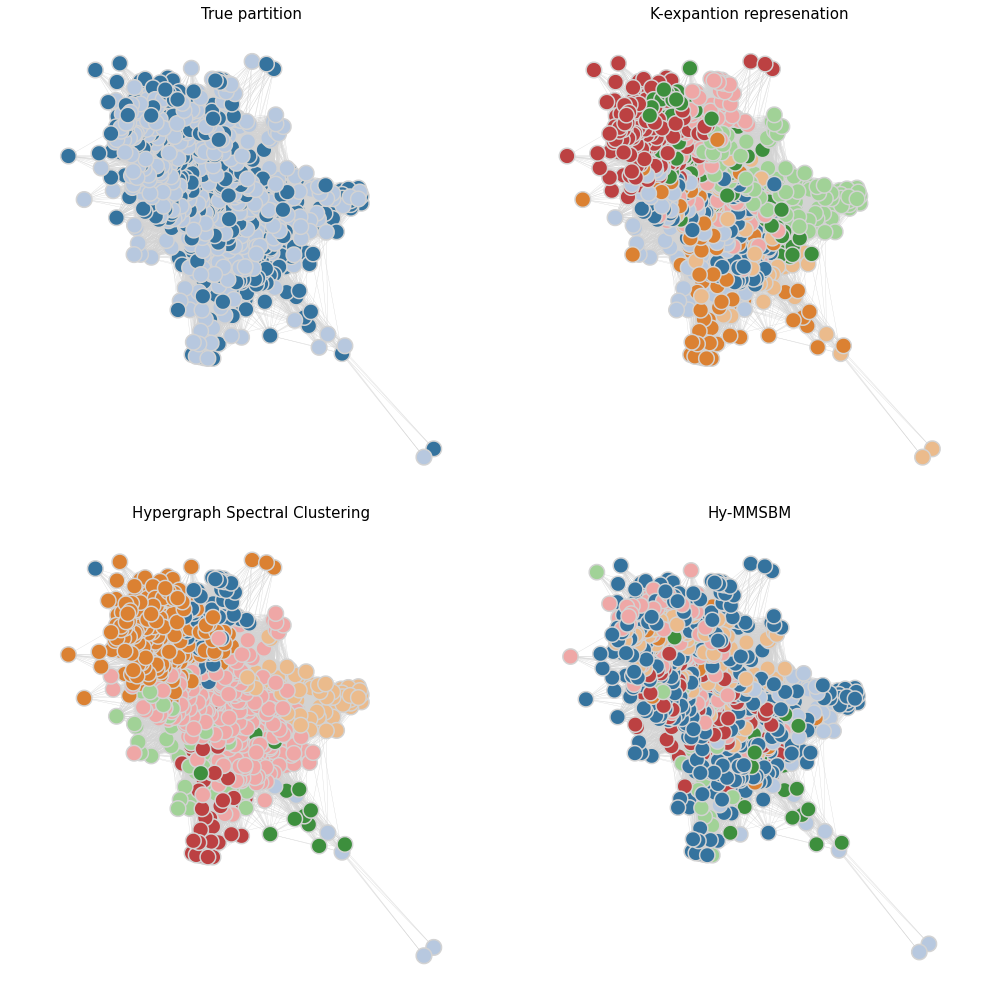

-----------------------------------------------------------------------------------
Spectral clustering with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -8.002364892513942e-05
Normalized Mutual Information (NMI): 0.0005042055580820664
Conductance: 0.24561059342815106
Generalized Conductance: 96.4577455359781


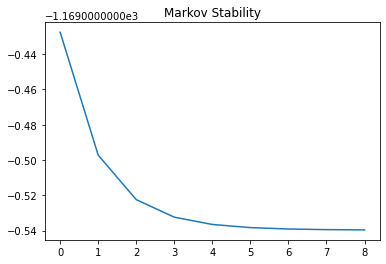

-----------------------------------------------------------------------------------
HyMMSBM with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 4.436151512049576e-05
Normalized Mutual Information (NMI): 0.001210163705490063
Conductance: 0.5201905317390881
Generalized Conductance: 89.88987344658806


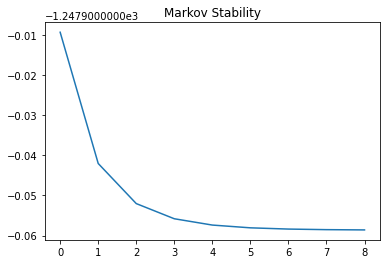

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


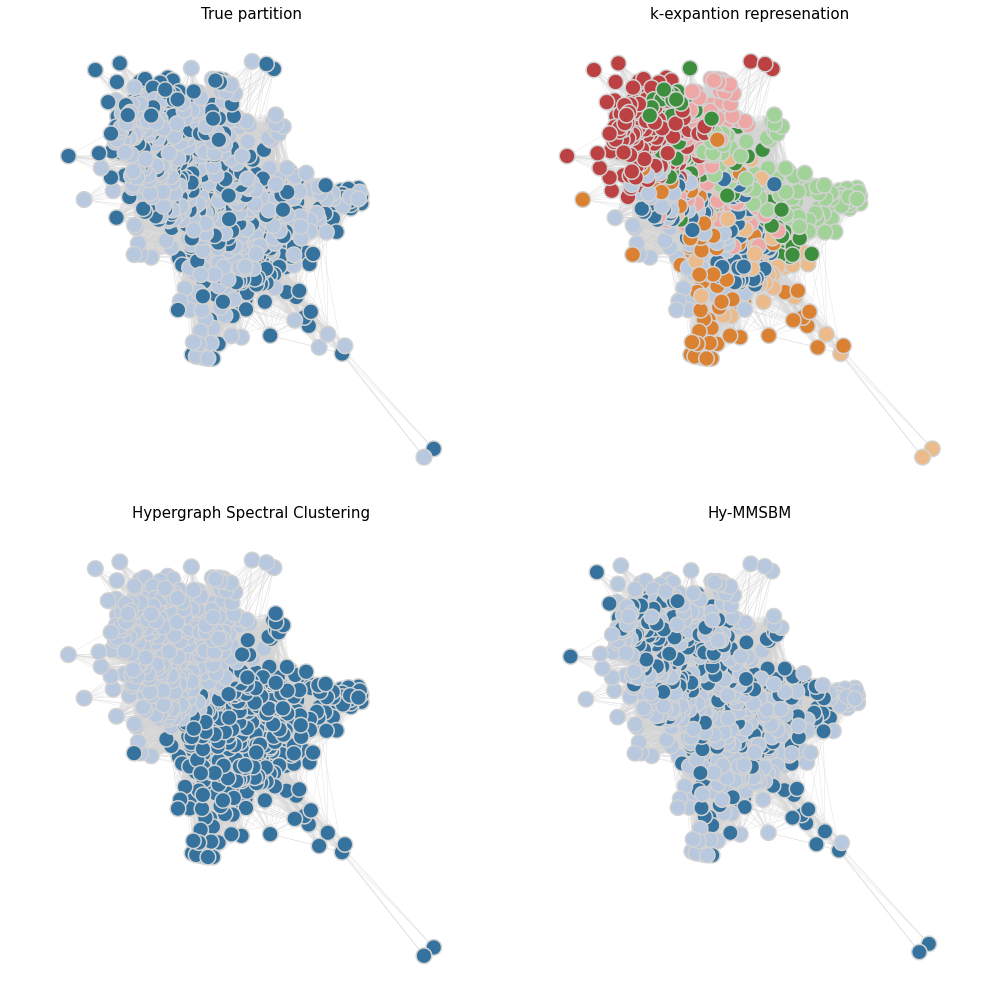

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


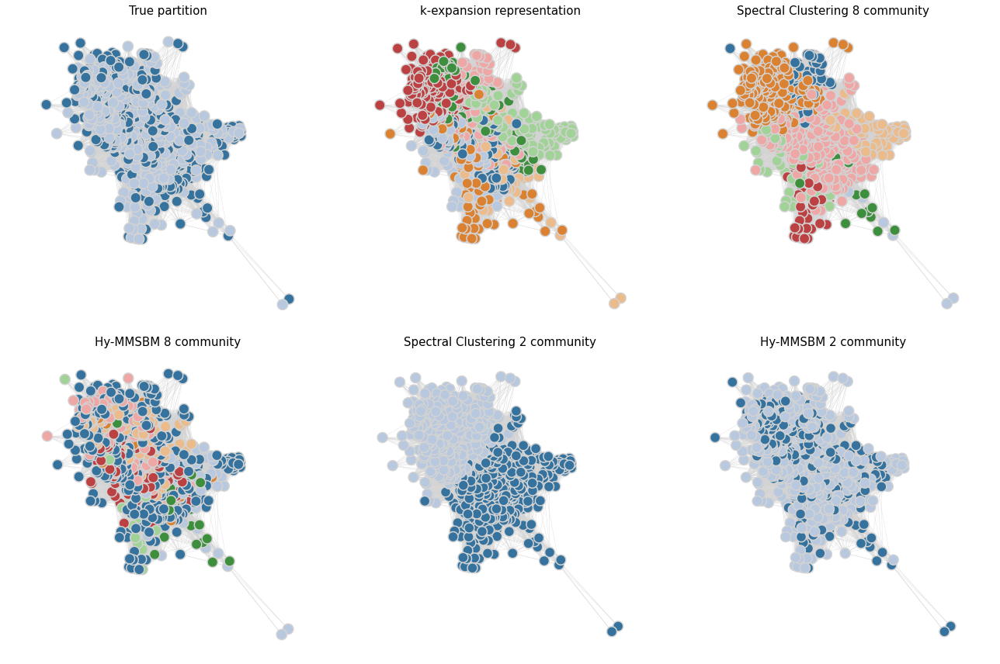

-----------------------------------------------------------------------------------
Spectral clustering choose of K
-----------------------------------------------------------------------------------
Number of communities:  2
Adjusted Rand Index (ARI): -8.002364892513942e-05
Normalized Mutual Information (NMI): 0.0005042055580820664
Conductance: 0.24561059342815106
Generalized Conductance: 96.4577455359781
Number of communities:  3
Adjusted Rand Index (ARI): -0.00025024929845064226
Normalized Mutual Information (NMI): 0.0005009098063131234
Conductance: 0.4621942131325845
Generalized Conductance: 233.6172980948448


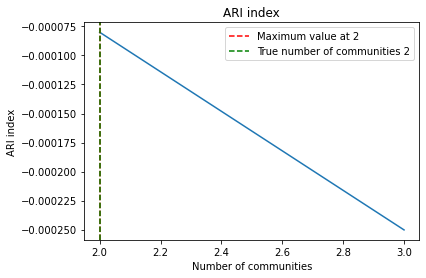

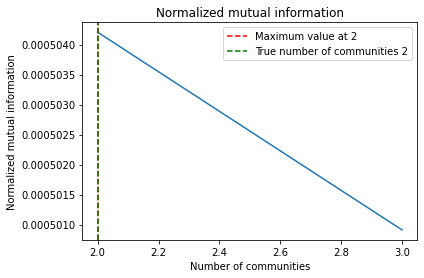

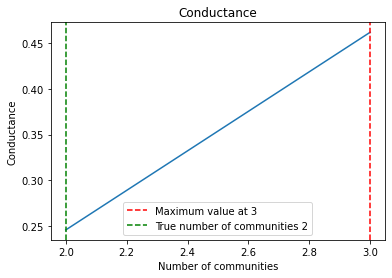

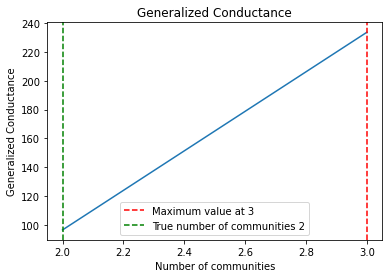

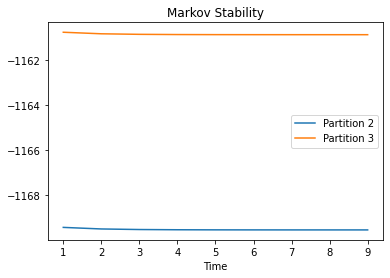

-----------------------------------------------------------------------------------
HyMMSBM choose of K
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0008695795774595659
Normalized Mutual Information (NMI): 0.00020490806728244335
Conductance: 0.5394296870132298
Generalized Conductance: 109.53888498620829
Adjusted Rand Index (ARI): -0.0007186144330666255
Normalized Mutual Information (NMI): 0.00038547982472293837
Conductance: 0.5095276881152775
Generalized Conductance: 96.081384876581


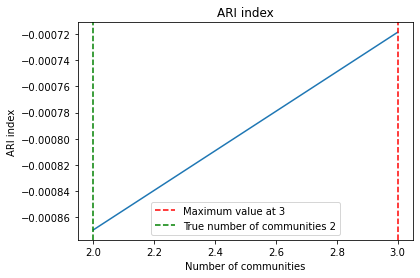

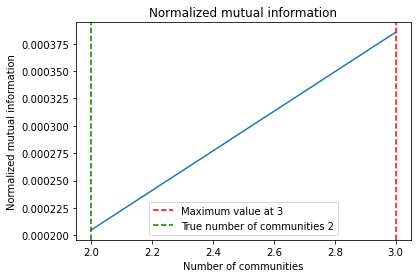

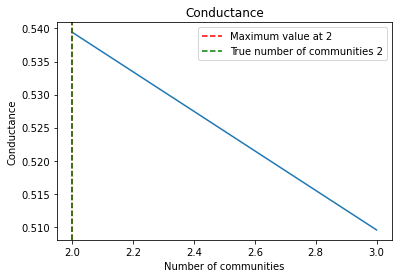

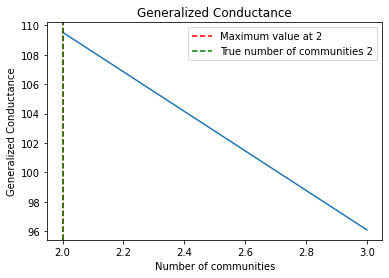

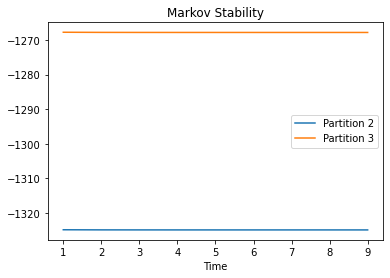

In [27]:
empirical_analysis_project(committee_house_hyperedges, true_partition_congress_committies,
                           true_matrix_congress_committies, min_number, max_number, number_community,number_community)

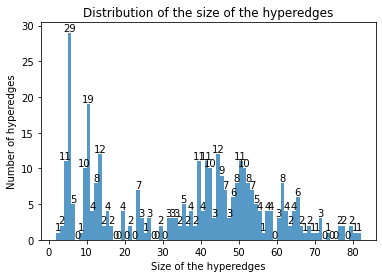

<Figure size 432x288 with 0 Axes>

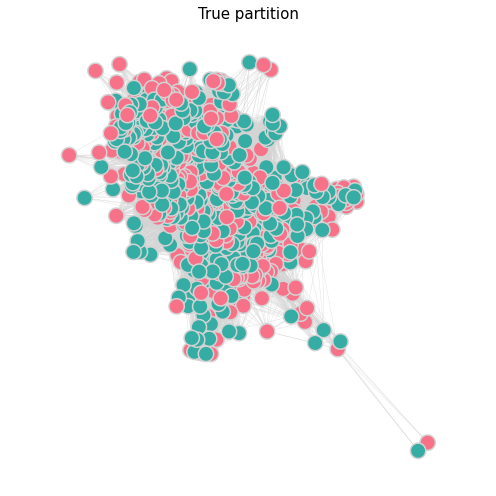

-----------------------------------------------------------------------------------
K -clique reduction
-----------------------------------------------------------------------------------


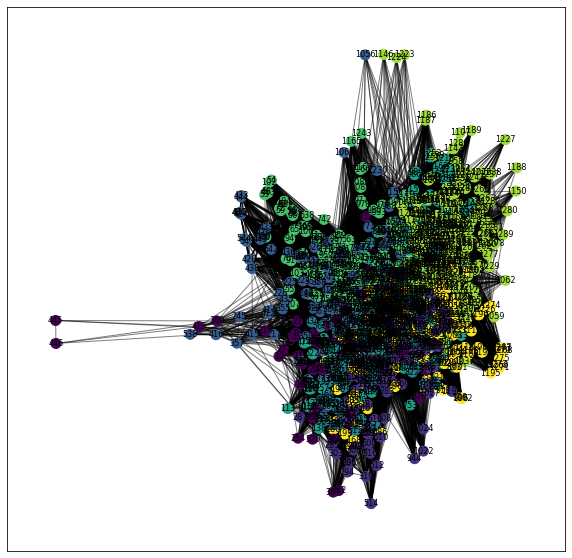

Adjusted Rand Index (ARI): 0.0014717171655690177
Normalized Mutual Information (NMI): 0.0014811227383791806
Conductance: 0.6118208939788705
Generalized Conductance: 628.1200961628512


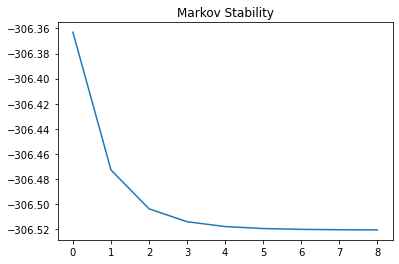

Number of partitions of K -clique reduction:  8
-----------------------------------------------------------------------------------
K -clique reduction weighting the hyperedges
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0009713022455947475
Normalized Mutual Information (NMI): 0.0008805635339436184
Conductance: 0.6941277768612654
Generalized Conductance: 854.7874325368095


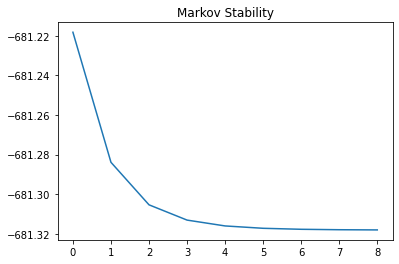

Number of partitions of K -clique reduction weighting the hyperedges:  7
-----------------------------------------------------------------------------------
Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.002597030730409162
Normalized Mutual Information (NMI): 0.0025490359066251914
Conductance: 0.7252234328981401
Generalized Conductance: 901.0632879424186
Number of partitions:  11
-----------------------------------------------------------------------------------
Weighted Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.001553386849610441
Normalized Mutual Information (NMI): 0.0026943043874938905
Conductance: 0.9053700111853197
Generalized Conductance: 1040.212830499869
Number of partitions:  11
-----------------------------------------------------------------------------------
Spectral clustering with number

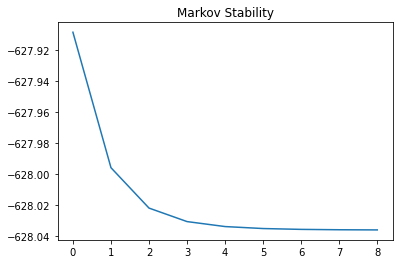

-----------------------------------------------------------------------------------
HyMMSBM with number of community of modularity
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.0004059686909279117
Normalized Mutual Information (NMI): 0.0016845442844187865
Conductance: 0.801589060209754
Generalized Conductance: 641.1834915354344


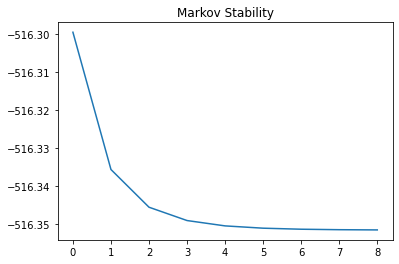

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


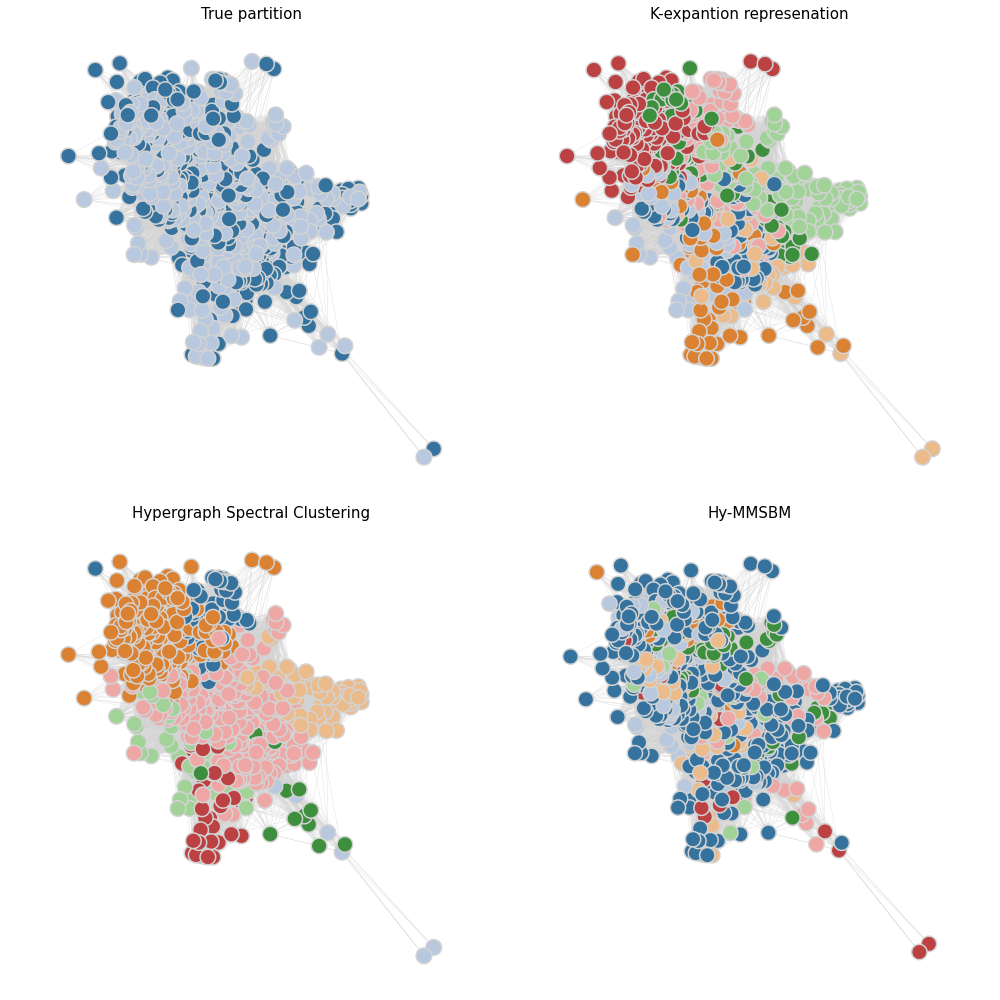

-----------------------------------------------------------------------------------
Spectral clustering with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -8.002364892513942e-05
Normalized Mutual Information (NMI): 0.0005042055580820664
Conductance: 0.24561059342815106
Generalized Conductance: 96.4577455359781


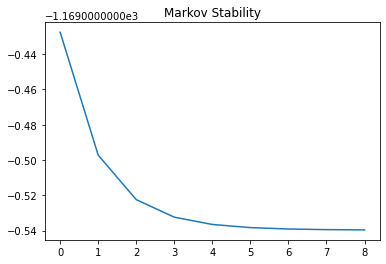

-----------------------------------------------------------------------------------
HyMMSBM with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0006904236146494378
Normalized Mutual Information (NMI): 9.135988346030062e-05
Conductance: 0.5358060888424773
Generalized Conductance: 90.5027948594351


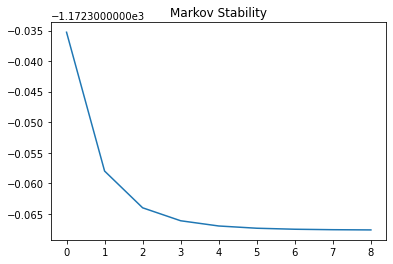

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


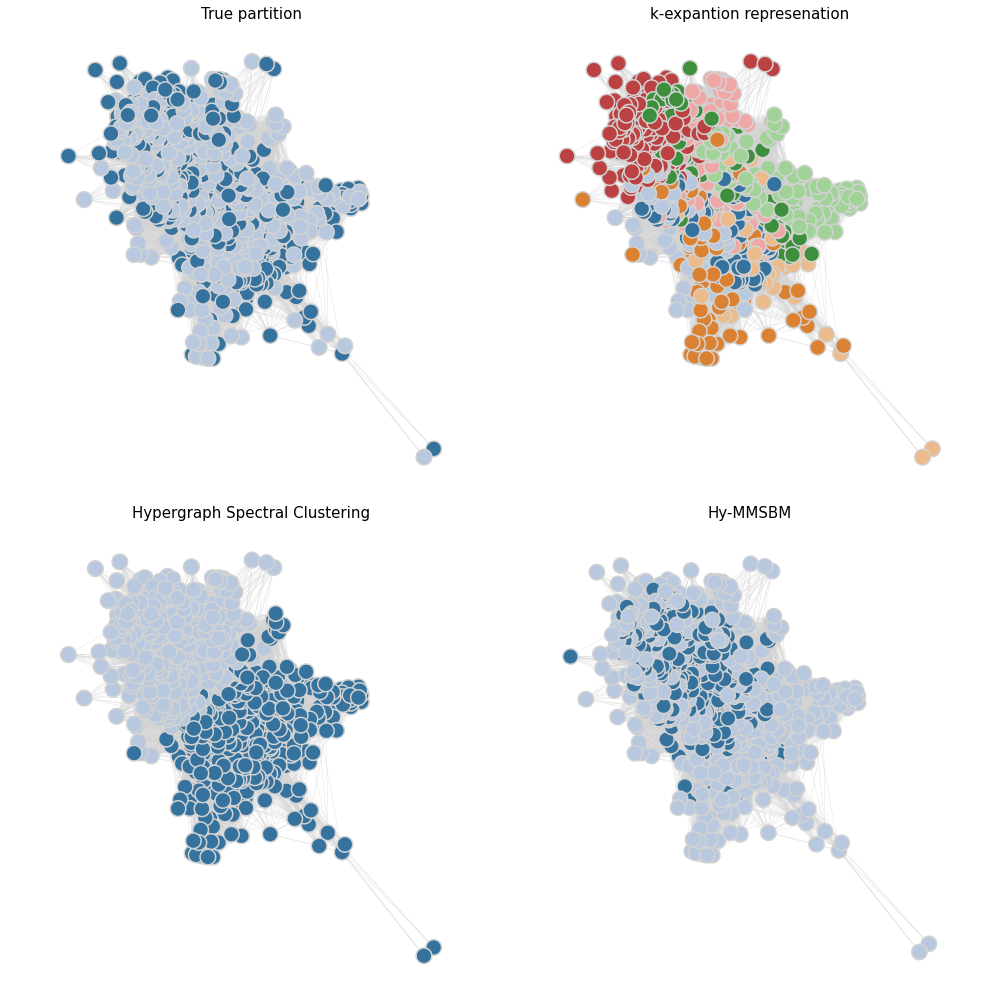

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


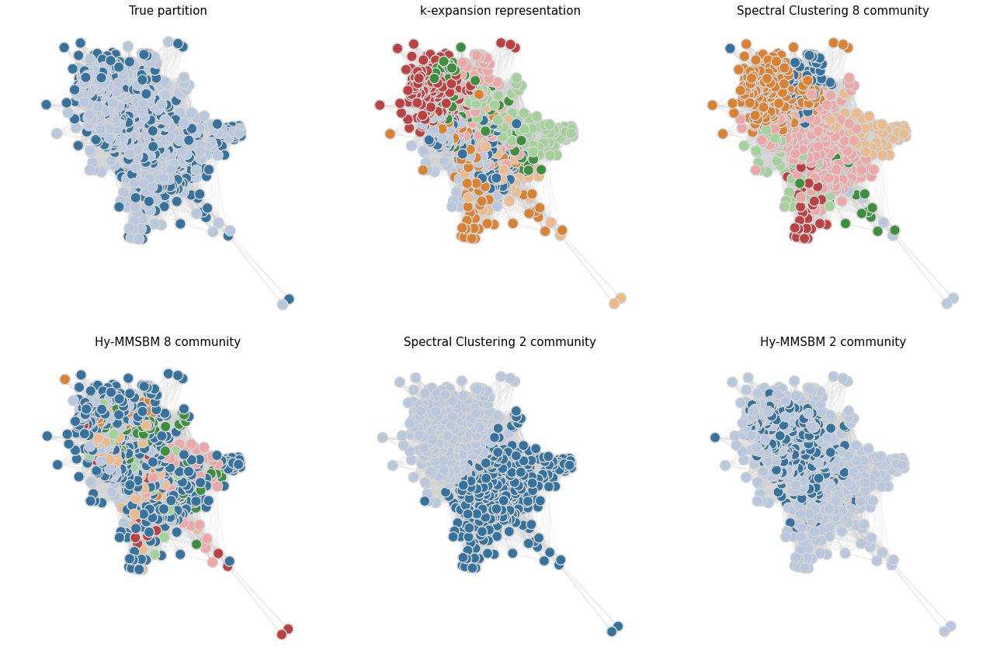

-----------------------------------------------------------------------------------
Different assortative
-----------------------------------------------------------------------------------


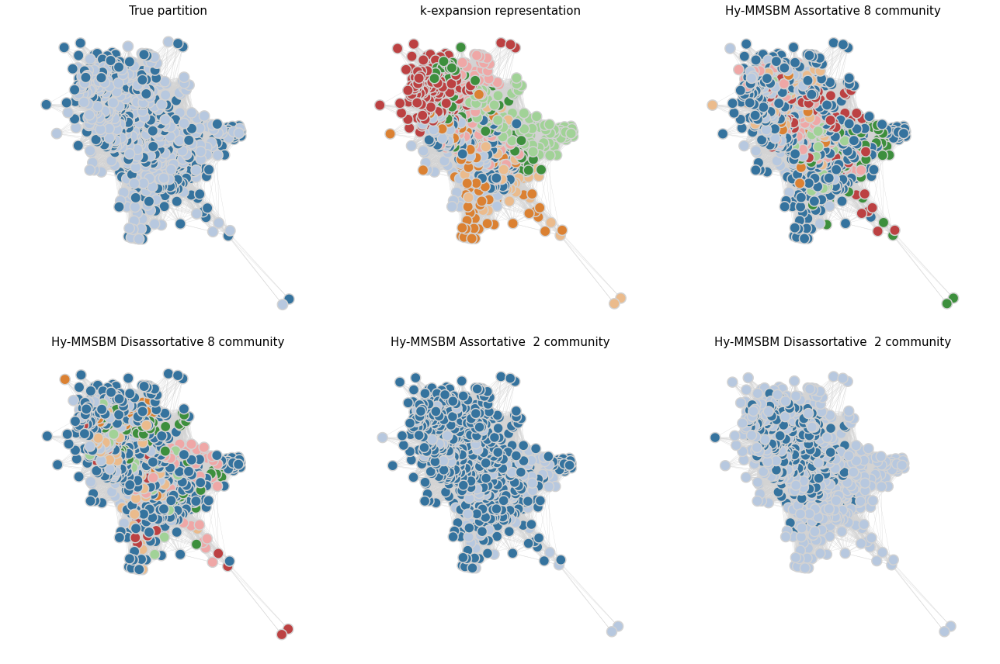

-----------------------------------------------------------------------------------
Spectral clustering choose of K
-----------------------------------------------------------------------------------
Number of communities:  2
Adjusted Rand Index (ARI): -8.002364892513942e-05
Normalized Mutual Information (NMI): 0.0005042055580820664
Conductance: 0.24561059342815106
Generalized Conductance: 96.4577455359781
Number of communities:  3
Adjusted Rand Index (ARI): -0.00025024929845064226
Normalized Mutual Information (NMI): 0.0005009098063131234
Conductance: 0.4621942131325845
Generalized Conductance: 233.6172980948448


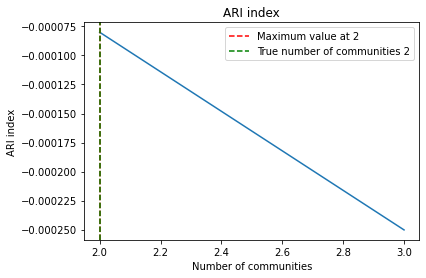

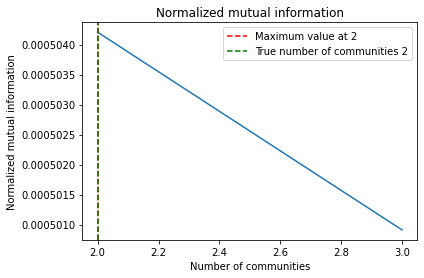

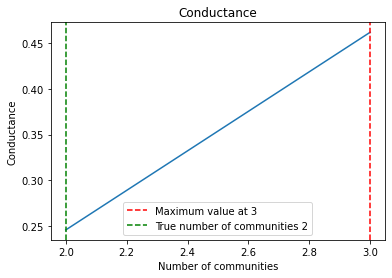

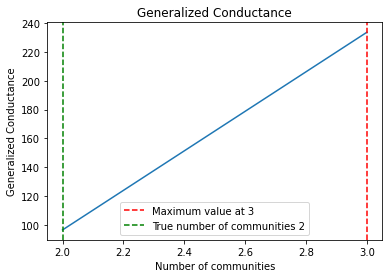

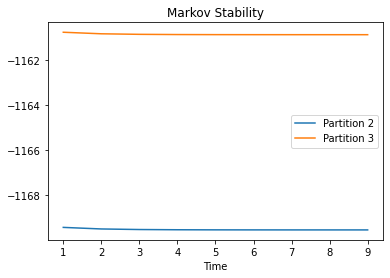

-----------------------------------------------------------------------------------
HyMMSBM choose of K
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.000628433636565492
Normalized Mutual Information (NMI): 0.0010625256881750657
Conductance: 0.5897191932596367
Generalized Conductance: 105.55469664727723
Adjusted Rand Index (ARI): 0.00036498117225085806
Normalized Mutual Information (NMI): 0.002412973195088498
Conductance: 0.5844035316544597
Generalized Conductance: 122.8210486206568


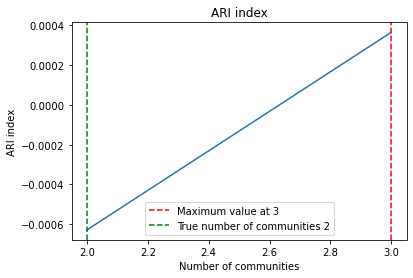

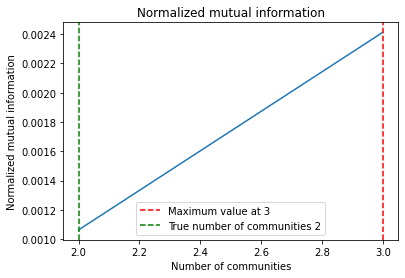

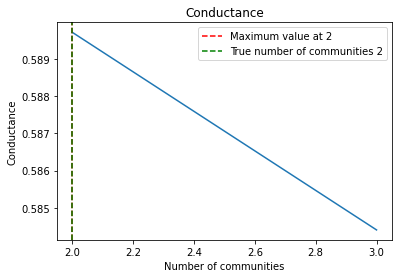

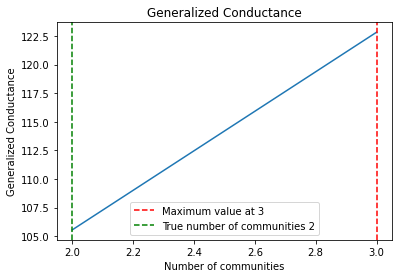

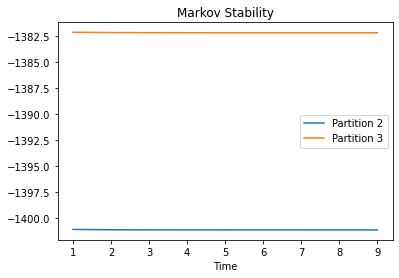

In [28]:
empirical_analysis_project(committee_house_hyperedges, true_partition_congress_committies,
                           true_matrix_congress_committies, min_number, max_number, number_community,number_community,assortative=False)

## Ernon

In [29]:
file_path_ernon = '../data/ernon/enron-email.npz'
file_path_ground_truth_ernon = '../data/ernon/enron-email_meta.csv'
hyperedges_ernon = import_from_npz(file_path_ernon)

In [30]:
data = pd.read_csv(file_path_ground_truth_ernon)
map = {'periphery': 0, 'core': 1}
data['CorePeriphery'] = data['CorePeriphery'].map(map)
true_community = {}
true_matrix = {}
for i in range(len(data)):
    if data['CorePeriphery'][i] not in true_community:
        true_community[data['CorePeriphery'][i]] = []
    true_community[data['CorePeriphery'][i]].append(data['nodeID'][i])
    true_matrix[data['nodeID'][i]] = data['CorePeriphery'][i]

number_community = len(true_community)
matrix = np.zeros((len(true_matrix), number_community))
for i in range(len(true_matrix)):
    matrix[i][true_matrix[i]-1] = 1

true_partition_ernon = true_community
true_matrix_ernon = matrix

number_community = true_matrix_ernon.shape[1]


In [31]:
print("True number of communities ernon: ", number_community)
min_number = 2
max_number = 6

True number of communities ernon:  2


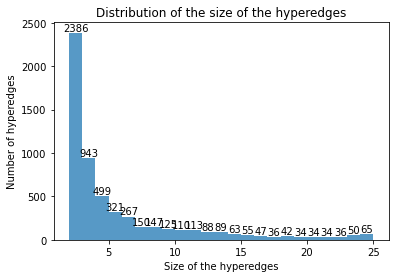

<Figure size 432x288 with 0 Axes>

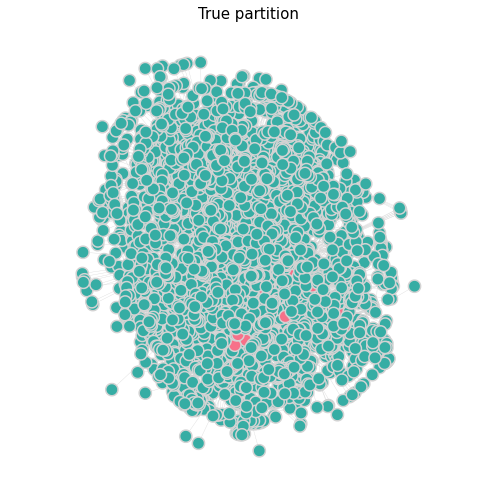

-----------------------------------------------------------------------------------
K -clique reduction
-----------------------------------------------------------------------------------


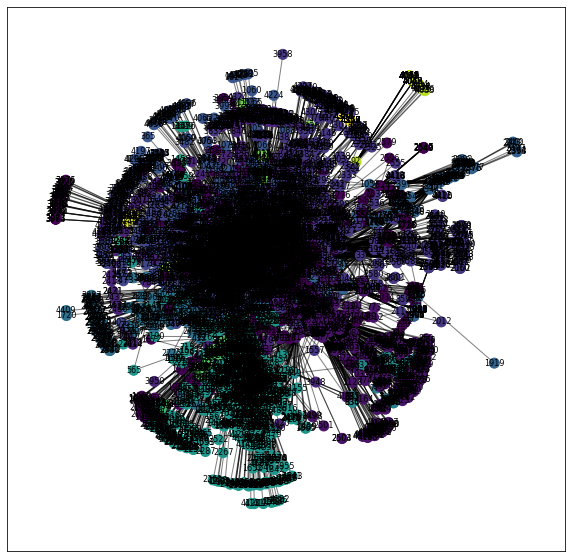

Adjusted Rand Index (ARI): 0.0008426159057189288
Normalized Mutual Information (NMI): 0.002220969428240639
Conductance: 0.1966220887887174
Generalized Conductance: 36.17482811074285


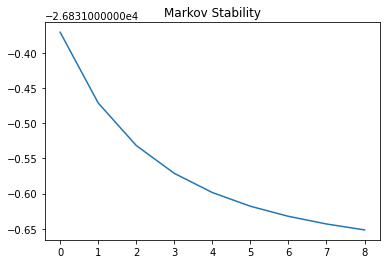

Number of partitions of K -clique reduction:  20
-----------------------------------------------------------------------------------
K -clique reduction weighting the hyperedges
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.001979153780456858
Normalized Mutual Information (NMI): 0.001226826985270285
Conductance: 0.39346051314434155
Generalized Conductance: 78.15779202503191


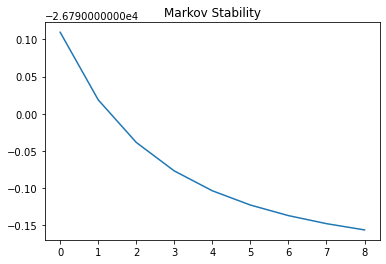

Number of partitions of K -clique reduction weighting the hyperedges:  20
-----------------------------------------------------------------------------------
Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.000356741410015338
Normalized Mutual Information (NMI): 0.0020470320434723493
Conductance: 0.31149958672418154
Generalized Conductance: 43.031487627053345
Number of partitions:  35
-----------------------------------------------------------------------------------
Weighted Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.003364336778639541
Normalized Mutual Information (NMI): 0.001409966580404355
Conductance: 0.5315494760569696
Generalized Conductance: 110.85691796364453
Number of partitions:  30
-----------------------------------------------------------------------------------
Spectral clustering with numb

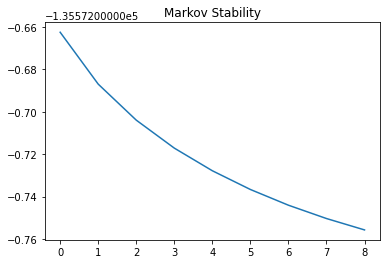

-----------------------------------------------------------------------------------
HyMMSBM with number of community of modularity
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.010196475357213191
Normalized Mutual Information (NMI): 0.002271221715615232
Conductance: 0.6905882262739856
Generalized Conductance: 126.21766702749355


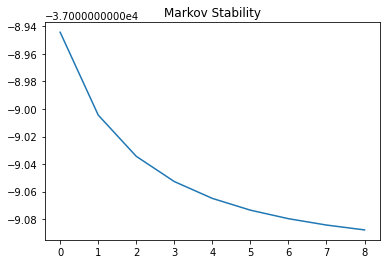

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


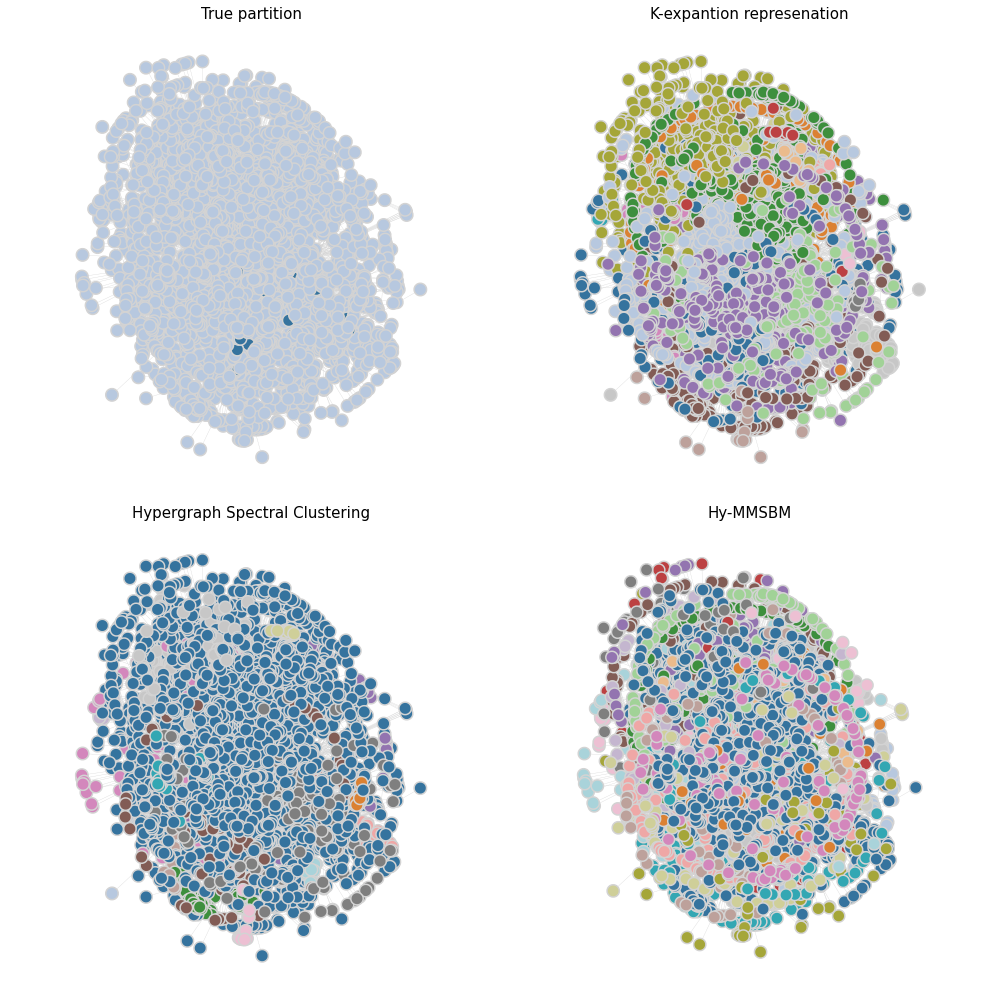

-----------------------------------------------------------------------------------
Spectral clustering with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.007497697141461296
Normalized Mutual Information (NMI): 0.0003186135067877885
Conductance: 0.09616775126536514
Generalized Conductance: 9.347878330099714


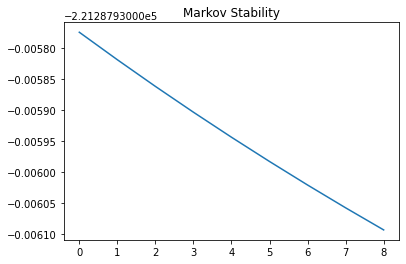

-----------------------------------------------------------------------------------
HyMMSBM with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.005273102313279472
Normalized Mutual Information (NMI): 0.00029058425321171227
Conductance: 0.3946879723601814
Generalized Conductance: 15.164549004211615


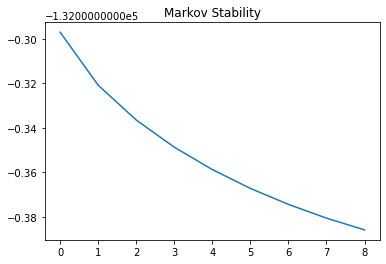

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


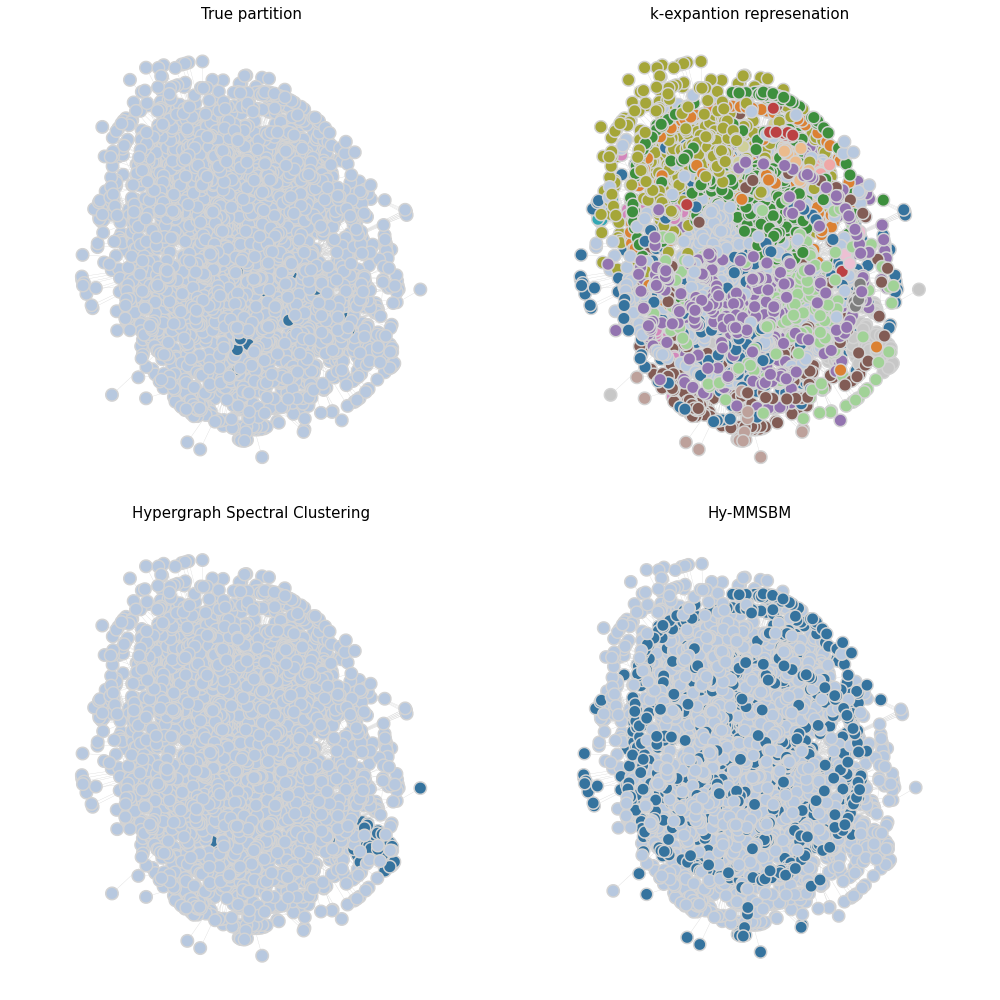

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


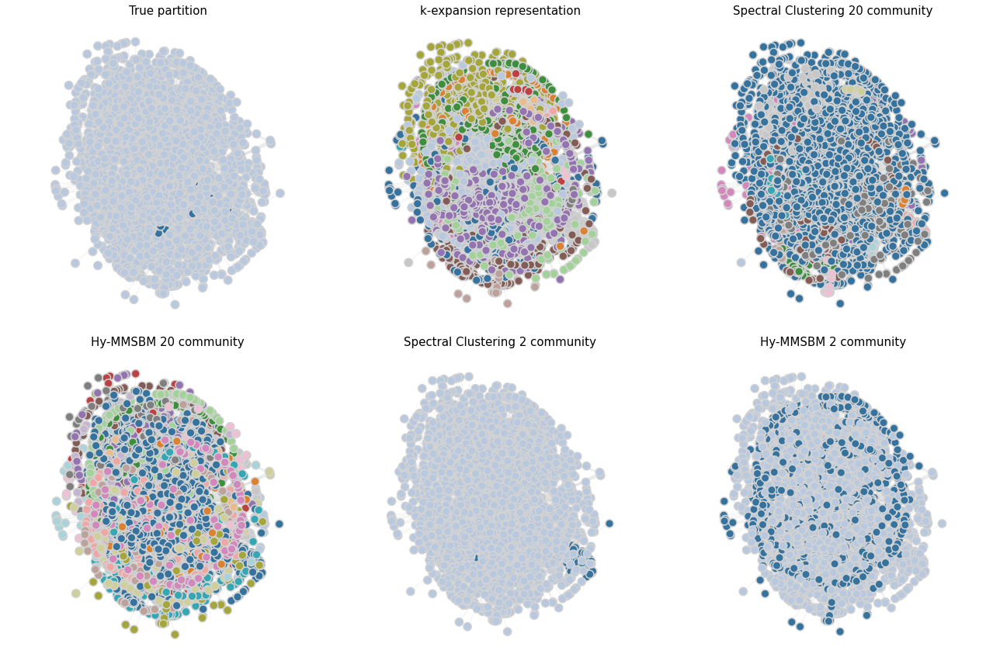

-----------------------------------------------------------------------------------
Spectral clustering choose of K
-----------------------------------------------------------------------------------
Number of communities:  2
Adjusted Rand Index (ARI): -0.007497697141461296
Normalized Mutual Information (NMI): 0.0003186135067877885
Conductance: 0.09616775126536514
Generalized Conductance: 9.347878330099714
Number of communities:  3
Adjusted Rand Index (ARI): 0.034012716037681606
Normalized Mutual Information (NMI): 0.0031014455816105657
Conductance: 0.23273526854956575
Generalized Conductance: 14.915241132584933
Number of communities:  4
Adjusted Rand Index (ARI): 0.035206384690431004
Normalized Mutual Information (NMI): 0.0031024633893253256
Conductance: 0.19334910591975746
Generalized Conductance: 14.447606630062268
Number of communities:  5
Adjusted Rand Index (ARI): 0.03856195227136677
Normalized Mutual Information (NMI): 0.0034720535806355775
Conductance: 0.20884007256359544
Gener

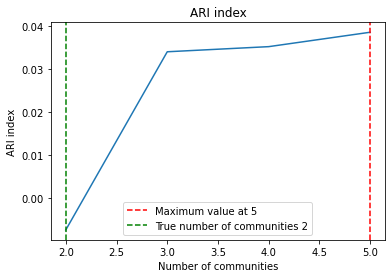

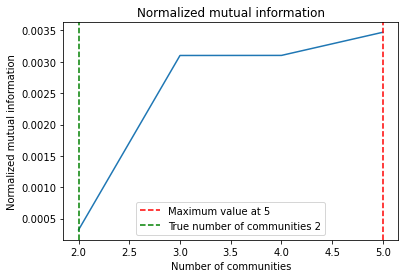

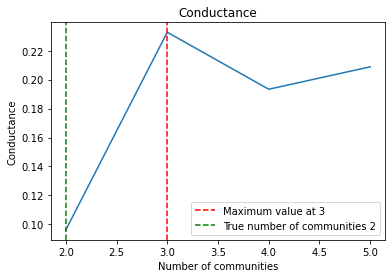

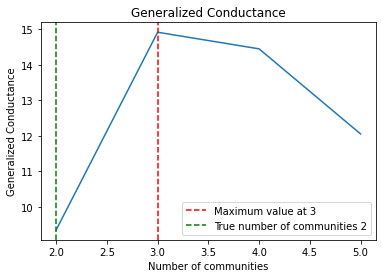

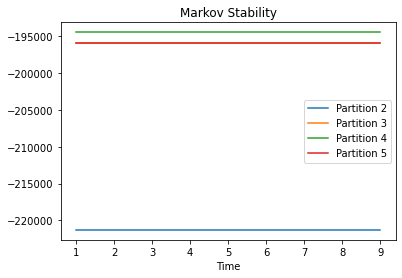

-----------------------------------------------------------------------------------
HyMMSBM choose of K
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.012762657339384883
Normalized Mutual Information (NMI): 0.001029932072456658
Conductance: 0.4219980198953373
Generalized Conductance: 14.813267746280841
Adjusted Rand Index (ARI): 0.011248158121028782
Normalized Mutual Information (NMI): 0.0012997161530805099
Conductance: 0.4473119305442923
Generalized Conductance: 16.625666455258575
Adjusted Rand Index (ARI): 0.016561817178673215
Normalized Mutual Information (NMI): 0.0033365236312545288
Conductance: 0.46114922546797876
Generalized Conductance: 18.209006980457218
Adjusted Rand Index (ARI): 0.01115272651788673
Normalized Mutual Information (NMI): 0.0006410764611150926
Conductance: 0.43367025432914075
Generalized Conductance: 14.059061889578196


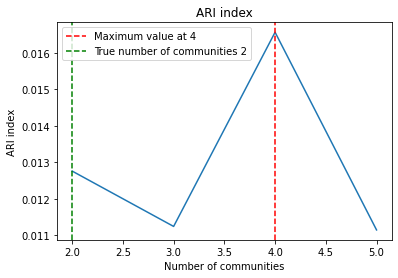

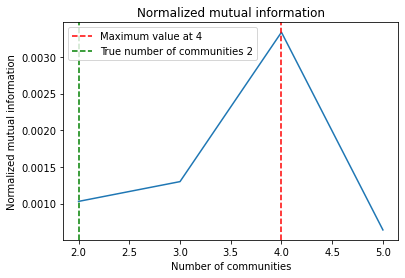

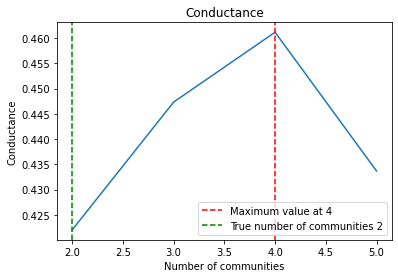

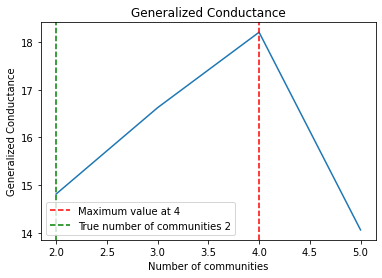

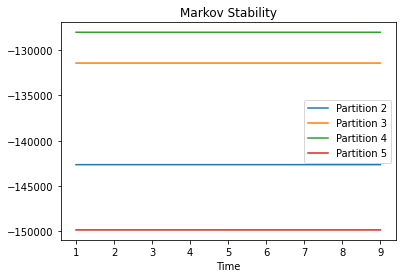

In [32]:
empirical_analysis_project(hyperedges_ernon, true_partition_ernon,
                           true_matrix_ernon, min_number, max_number, number_community, number_community)